# T-S diagrams and comparison

For reference: https://github.com/COSIMA/cosima-recipes/blob/master/DocumentedExamples/TemperatureSalinityDiagrams.ipynb

In [190]:
import dask
import dask.array as da
import dask.dataframe as dd
from dask import delayed
import numpy as np
import xarray as xr
from distributed.diagnostics.progressbar import progress
import cosima_cookbook as cc
import gsw
import cf_xarray as cfxr
from xhistogram.xarray import histogram as xhistogram

import matplotlib.pyplot as plt
import matplotlib.colors as colors
import cmocean as cmo


import logging
logging.captureWarnings(True)
logging.getLogger('py.warnings').setLevel(logging.ERROR)

In [191]:
from dask.distributed import Client
client = Client()
display(client)

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/41771/status,
Dashboard: /proxy/41771/status,Workers: 5
Total threads: 20,Total memory: 200.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:44095,Workers: 5
Dashboard: /proxy/41771/status,Total threads: 20
Started: Just now,Total memory: 200.00 GiB
Comm: tcp://127.0.0.1:45755,Total threads: 4
Dashboard: /proxy/37055/status,Memory: 40.00 GiB
Nanny: tcp://127.0.0.1:38313,


In [192]:
# database for control simulation:
session_name = '/g/data/v45/wf4500/databases/gdata_01deg_jra55v13_ryf9091_DSW.db'
master_session = cc.database.create_session(session_name)
control = '01deg_jra55v13_ryf9091_DSW'
#session_name = '/home/156/wf4500/databases/access/DSW.db'
#master_session = cc.database.create_session(session_name)
#control = '01deg_jra55v13_ryf9091_21mbath'

# basal melt experiments
basal_gade = '01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb'#'accessom2-GPC023'
icb_gade = '01deg_jra55v13_ryf9091_DSW_BasalGade_YesIcb'#'accessom2-GPC026'
basal_nogade = '01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb'

start_time='1909-01-01'
end_time='1910-01-01'

lat_slice = slice(-80,-59)
lon_slice = slice(-280,80)

In [193]:
# build database for basal melt experiments:
#session_name = '/g/data/e14/pc5520/model_data/access-om2/basal_melt_MOM5/basal_melt_MOM5.db'
session_name = '/g/data/ik11/databases/basal_melt_MOM5.db'
basal_melt_session = cc.database.create_session(session_name)

Get bathymetry. 

In [194]:
# get bathymetry
ht = cc.querying.getvar(control, 'ht', master_session, n=1).sel(yt_ocean=lat_slice)

In [195]:
def shelf_mask_isobath(var):
    '''
    Masks ACCESS-OM2-01 variables by the region polewards of the 1000m isobath as computed using 
    a script contributed by Adele Morrison.
    Only to be used with ACCESS-OM2-0.1 output!
    '''
    contour_file = np.load('/g/data/ik11/grids/Antarctic_slope_contour_1000m.npz')
    
    shelf_mask = contour_file['contour_masked_above']
    yt_ocean = contour_file['yt_ocean']
    xt_ocean = contour_file['xt_ocean']
    
    # in this file the points along the isobath are given a positive value, the points outside (northwards) 
    # of the isobath are given a value of -100 and all the points on the continental shelf have a value of 0 
    # so we mask for the 0 values 
    shelf_mask[np.where(shelf_mask!=0)] = np.nan
    shelf_mask = shelf_mask+1
    shelf_map = np.nan_to_num(shelf_mask)
    shelf_mask = xr.DataArray(shelf_mask, coords = [('yt_ocean', yt_ocean), ('xt_ocean', xt_ocean)])
    shelf_map = xr.DataArray(shelf_map, coords = [('yt_ocean', yt_ocean), ('xt_ocean', xt_ocean)])
    
    # then we want to multiply the variable with the mask so we need to account for the shape of the mask. 
    # The mask uses a northern cutoff of 59S.
    masked_var = var.sel(yt_ocean = slice(-90, -59.03)) * shelf_mask
    masked_var = masked_var.rename(var.name)
    masked_var.attrs['units'] = var.attrs['units']
    return masked_var, shelf_map

# Histogram T-S plots

In [196]:
# dictionary of variable names and time for mom5 
vars_args = {
    "mom5": {
        "var_temp": 'temp',
        "var_salt": 'salt',
        "var_area": 'area_t'},}


def gsw_SA_from_SP(salt, lon_name):
    """function to convert practical salinity to absolute salinity
    using the Gibbs SeaWater (GSW) Oceanographic Toolbox of TEOS-10
    (https://teos-10.github.io/GSW-Python/)
    
    input:
        -salt: practical salinity (array)
        -lon_name: name of the longitude (str)
    output:
        -salt_abs: absolute salinity (array)
    """
    pres = gsw.p_from_z(-salt.cf['vertical'], salt.cf['latitude'])
    salt_abs = gsw.SA_from_SP(salt, pres, salt[lon_name], salt.cf['latitude'])
    salt_abs.attrs = {'units': 'Absolute Salinity (g/kg)'}
    return salt_abs

# a function to load salinity
def load_salinity(model, session):
    salt = cc.querying.getvar(
        variable=vars_args[model].get('var_salt'), session=session, frequency='1 monthly',
        **expt_args[model])
    lon_name = salt.cf['longitude'].name
    # select longitude, latitude range and time
    salt = salt.cf.sel(longitude=lon_slice).cf.sel(
        latitude=lat_slice, time=slice(start_time, end_time))
    # convert from practical to absolute salinity
    salt = gsw_SA_from_SP(salt, lon_name)
    return salt

# a function to load temperature
def load_temperature(model, session):
    temp = cc.querying.getvar(
        variable=vars_args[model].get('var_temp'), session=session, frequency='1 monthly',
        **expt_args[model])
    # select longitude, latitude range and time
    temp = temp.cf.sel(longitude=lon_slice).cf.sel(
        latitude=lat_slice, time=slice(start_time, end_time))
    temp = temp - 273.15
    temp.attrs = {'units': 'Conservative temperature (°C)'}
    return temp

# a function to load area of grid cells
def load_grid_areas(model, session):
    area = cc.querying.getvar(
        variable=vars_args[model].get('var_area'), session=session, n=1,
        **expt_args[model])
    if model == 'mom5':
        area = area.drop(['geolon_t', 'geolat_t'])
    # select longitude and latitude range
    area = area.cf.sel(longitude=lon_slice).cf.sel(
        latitude=lat_slice)
    return area

Load data

In [197]:
%%time
# dictionary of experiment name and time for mom5 
expt = '01deg_jra55v13_ryf9091_DSW'
expt_args = {"mom5": {
        "expt": f"{expt}",
        "start_time": "1909-01-01",
        "end_time": "1910-12-31"},}
print(expt_args)
model = 'mom5'  # 'mom5' or 'mom6'
salt = load_salinity(model, master_session)
temp = load_temperature(model, master_session)
area = load_grid_areas(model, master_session)
# mask to shelf
salt, shelf_map = shelf_mask_isobath(salt)
temp, shelf_map = shelf_mask_isobath(temp)
area, shelf_map = shelf_mask_isobath(area)

expt = basal_gade
expt_args = {"mom5": {
        "expt": f"{expt}",
        "start_time": "1909-01-01",
        "end_time": "1910-12-31"},}
print(expt_args)
salt_basal = load_salinity(model, basal_melt_session)
temp_basal = load_temperature(model, basal_melt_session)
area_basal = load_grid_areas(model, basal_melt_session)
salt_basal, shelf_map = shelf_mask_isobath(salt_basal)
temp_basal, shelf_map = shelf_mask_isobath(temp_basal)
area_basal, shelf_map = shelf_mask_isobath(area_basal)

expt = icb_gade
expt_args = {"mom5": {
        "expt": f"{expt}",
        "start_time": "1909-01-01",
        "end_time": "1910-12-31"},}
print(expt_args)
salt_icb = load_salinity(model, basal_melt_session)
temp_icb = load_temperature(model, basal_melt_session)
area_icb = load_grid_areas(model, basal_melt_session)
salt_icb, shelf_map = shelf_mask_isobath(salt_icb)
temp_icb, shelf_map = shelf_mask_isobath(temp_icb)
area_icb, shelf_map = shelf_mask_isobath(area_icb)

expt = basal_nogade
expt_args = {"mom5": {
        "expt": f"{expt}",
        "start_time": "1909-01-01",
        "end_time": "1910-12-31"},}
print(expt_args)
salt_basalnogade = load_salinity(model, basal_melt_session)
temp_basalnogade = load_temperature(model, basal_melt_session)
area_basalnogade = load_grid_areas(model, basal_melt_session)
salt_basalnogade, shelf_map = shelf_mask_isobath(salt_basalnogade)
temp_basalnogade, shelf_map = shelf_mask_isobath(temp_basalnogade)
area_basalnogade, shelf_map = shelf_mask_isobath(area_basalnogade)

{'mom5': {'expt': '01deg_jra55v13_ryf9091_DSW', 'start_time': '1909-01-01', 'end_time': '1910-12-31'}}
{'mom5': {'expt': '01deg_jra55v13_ryf9091_DSW_BasalGade_NoIcb', 'start_time': '1909-01-01', 'end_time': '1910-12-31'}}
{'mom5': {'expt': '01deg_jra55v13_ryf9091_DSW_BasalGade_YesIcb', 'start_time': '1909-01-01', 'end_time': '1910-12-31'}}
{'mom5': {'expt': '01deg_jra55v13_ryf9091_DSW_BasalNoGade_NoIcb', 'start_time': '1909-01-01', 'end_time': '1910-12-31'}}
CPU times: user 5.03 s, sys: 626 ms, total: 5.66 s
Wall time: 13.1 s


Create historgrams

In [198]:
# a function that computes the temperature and salinity bins for 2D histogram 
def compute_TS_bins(salt, temp, area):
    temp_bins = np.arange(np.floor(temp.min().values), np.ceil(temp.max().values+2), 0.5)
    salt_bins = np.arange(np.floor(salt.min().values), np.ceil(salt.max().values), 0.1)
    # for density contours in TS diagram
    temp_bins_mesh,salt_bins_mesh = np.meshgrid(temp_bins, salt_bins)
    TS_density = gsw.density.sigma0(salt_bins_mesh, temp_bins_mesh)
    # volume of grid cells to account for varying grid cells especially in the vertical
    vol = (temp.cf['vertical'] * area)

    # 2D histogram of temperature and salinity weighted by volume
    TS_hist = xhistogram(
        temp, salt, bins=(temp_bins, salt_bins), weights=vol)
    TS_hist = TS_hist.where(TS_hist != 0).compute()
    return TS_hist, TS_density, salt_bins_mesh, temp_bins_mesh 

In [199]:
%%time
TS_hist, TS_density, salt_bins_mesh, temp_bins_mesh = compute_TS_bins(salt, temp, area)
TS_hist_basal, TS_density_basal, salt_bins_mesh_basal, temp_bins_mesh_basal = compute_TS_bins(salt_basal, temp_basal, area_basal)
TS_hist_icb, TS_density_icb, salt_bins_mesh_icb, temp_bins_mesh_icb = compute_TS_bins(salt_icb, temp_icb, area_icb)
TS_hist_basalnogade, TS_density_basalnogade, salt_bins_mesh_basalnogade, temp_bins_mesh_basalnogade = compute_TS_bins(salt_basalnogade, temp_basalnogade, area_basalnogade)

/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice 

CPU times: user 6min 30s, sys: 26.7 s, total: 6min 57s
Wall time: 8min 23s


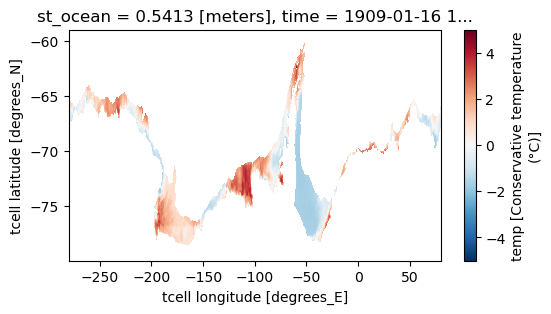

In [200]:
temp_basal.isel(time=0).isel(st_ocean=0).plot(figsize=(6,3))
plt.show()


Plot histograms

In [205]:
salt_arr = np.arange(25, 40, 0.1)
tfreeze_arr = gsw.CT_freezing(salt_arr, 1, 0.1)
tfreeze_arr_1000 = gsw.CT_freezing(salt_arr, 1000, 0.1)
tfreeze_arr_2000 = gsw.CT_freezing(salt_arr, 2000, 0.1)

# From ACCESS Tfreeze calculation
z = 1000.
press = z*1.0143#/10./10.
a0 =  2.5180516744541290e-03
a1 = -5.8545863698926184e-02
a2 =  2.2979985780124325e-03
a3 = -3.0086338218235500e-04
a4 = -7.0023530029351803e-04
a5 =  8.4149607219833806e-09
a6 =  1.1845857563107403e-11
b0 =  1.0000000000000000e+00
b1 = -3.8493266309172074e-05
b2 =  9.1686537446749641e-10
b3 =  1.3632481944285909e-06
c1 = -2.5180516744541290e-03
c2 =  1.428571428571429e-05
sqrts   = salt_arr**(0.5)
tf_num = a0 + salt_arr*(a1 + sqrts*(a2 + sqrts*a3)) + press*(a4 + press*(a5 + salt_arr*a6))
tf_den = b0 + press*(b1 + press*b2) + salt_arr*salt_arr*sqrts*b3
tfreeze = tf_num/tf_den + (c1 + salt_arr*c2)

In [206]:
z = 1000.
press = z*1.0143/10./10.
press

10.142999999999999

In [207]:
plt.rcParams.update({'font.size': 12})

Text(0, 0.5, 'Conservative temperature (°C)')

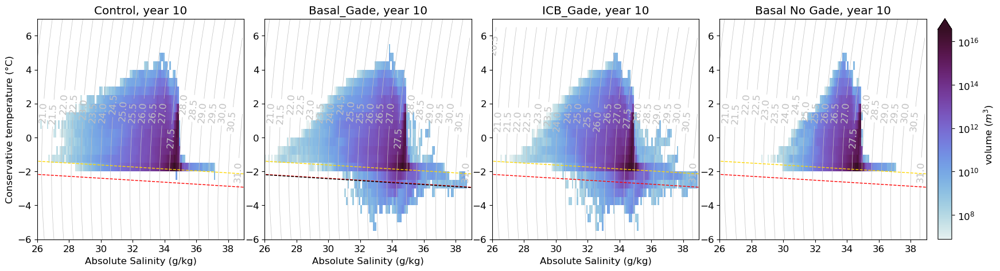

In [217]:
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,5))
plt.subplots_adjust(wspace=0.1)

norm=colors.LogNorm(vmin=TS_hist.min().values, vmax=TS_hist.max().values)

# Control
# volume weighted histogram of T and S
cb = axes[0].pcolormesh(TS_hist.salt_bin, TS_hist.temp_bin, TS_hist,  cmap=cmo.cm.dense, norm=norm)
# sigma_0 contours
cs = axes[0].contour(salt_bins_mesh_basal, temp_bins_mesh_basal, TS_density_basal, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_basal.min()),np.ceil(TS_density_basal.max()), .5), )
axes[0].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[0].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[0].set_ylim([-6, 7])
axes[0].set_xlim([26, 39])
plt.clabel(cs, inline=True)

# As above but for Basal_Gade
cb = axes[1].pcolormesh(TS_hist_basal.salt_bin, TS_hist_basal.temp_bin, TS_hist_basal,  cmap=cmo.cm.dense, norm=norm)
cs = axes[1].contour(salt_bins_mesh_basal, temp_bins_mesh_basal, TS_density_basal, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_basal.min()),np.ceil(TS_density_basal.max()), .5), 
                )
axes[1].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[1].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[1].plot(salt_arr, tfreeze, 'k', lw=1, ls='--')
plt.clabel(cs, inline=True)
axes[1].set_ylim([-6, 7])
axes[1].set_xlim([26, 39])

# As above but for ICB_Gade
cb = axes[2].pcolormesh(TS_hist_icb.salt_bin, TS_hist_icb.temp_bin, TS_hist_icb,  cmap=cmo.cm.dense, norm=norm)
cs = axes[2].contour(salt_bins_mesh_icb, temp_bins_mesh_icb, TS_density_icb, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_icb.min()),np.ceil(TS_density_icb.max()), .5), )
plt.clabel(cs, inline=True)
axes[2].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[2].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[2].set_ylim([-6, 7])
axes[2].set_xlim([26, 39])

# As above but for Basal_NoGade
cb = axes[3].pcolormesh(TS_hist_basalnogade.salt_bin, TS_hist_basalnogade.temp_bin, TS_hist_basalnogade,  cmap=cmo.cm.dense, norm=norm)
cs = axes[3].contour(salt_bins_mesh_basal, temp_bins_mesh_basal, TS_density_basal, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_basal.min()),np.ceil(TS_density_basal.max()), .5), )
plt.clabel(cs, inline=True)
axes[3].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[3].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[3].set_ylim([-6, 7])
axes[3].set_xlim([26, 39])

# add colorbar
cax = fig.add_axes([0.91, 0.11, 0.012, 0.77])
fig.colorbar(cb, cax=cax, orientation='vertical', extend='max', label='volume ($m^{3}$)')

# add titles
axes[0].set_title('Control, year 10')
axes[1].set_title('Basal_Gade, year 10')
axes[2].set_title('ICB_Gade, year 10')
axes[3].set_title('Basal No Gade, year 10')

# add axes labels
axes[0].set_xlabel(salt.units)
axes[1].set_xlabel(salt.units)
axes[2].set_xlabel(salt.units)
axes[0].set_ylabel(temp.units)


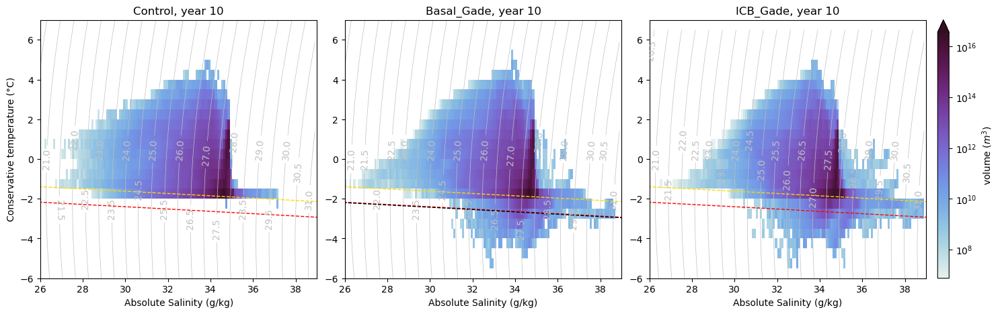

In [25]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(17,5))
plt.subplots_adjust(wspace=0.1)

norm=colors.LogNorm(vmin=TS_hist.min().values, vmax=TS_hist.max().values)

# Control
# volume weighted histogram of T and S
cb = axes[0].pcolormesh(TS_hist.salt_bin, TS_hist.temp_bin, TS_hist,  cmap=cmo.cm.dense, norm=norm)
# sigma_0 contours
cs = axes[0].contour(salt_bins_mesh_basal, temp_bins_mesh_basal, TS_density_basal, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_basal.min()),np.ceil(TS_density_basal.max()), .5), )
axes[0].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[0].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[0].set_ylim([-6, 7])
axes[0].set_xlim([26, 39])
plt.clabel(cs, inline=True)

# As above but for Basal_Gade
cb = axes[1].pcolormesh(TS_hist_basal.salt_bin, TS_hist_basal.temp_bin, TS_hist_basal,  cmap=cmo.cm.dense, norm=norm)
cs = axes[1].contour(salt_bins_mesh_basal, temp_bins_mesh_basal, TS_density_basal, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_basal.min()),np.ceil(TS_density_basal.max()), .5), 
                )
axes[1].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[1].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[1].plot(salt_arr, tfreeze, 'k', lw=1, ls='--')
plt.clabel(cs, inline=True)
axes[1].set_ylim([-6, 7])
axes[1].set_xlim([26, 39])

# As above but for ICB_Gade
cb = axes[2].pcolormesh(TS_hist_icb.salt_bin, TS_hist_icb.temp_bin, TS_hist_icb,  cmap=cmo.cm.dense, norm=norm)
cs = axes[2].contour(salt_bins_mesh_icb, temp_bins_mesh_icb, TS_density_icb, colors='silver',linewidths=0.5,
                 levels=np.arange(np.floor(TS_density_icb.min()),np.ceil(TS_density_icb.max()), .5), )
plt.clabel(cs, inline=True)
axes[2].plot(salt_arr, tfreeze_arr, 'gold', lw=1, ls='--')
axes[2].plot(salt_arr, tfreeze_arr_1000, 'r', lw=1, ls='--')
axes[2].set_ylim([-6, 7])
axes[2].set_xlim([26, 39])

# add colorbar
cax = fig.add_axes([0.91, 0.11, 0.01, 0.77])
fig.colorbar(cb, cax=cax, orientation='vertical', extend='max', label='volume ($m^{3}$)')

# add axes labels
axes[0].set_xlabel(salt.units)
axes[1].set_xlabel(salt.units)
axes[2].set_xlabel(salt.units)
axes[0].set_ylabel(temp.units)

# add titles
axes[0].set_title('Control, year 10')
axes[1].set_title('Basal_Gade, year 10')
axes[2].set_title('ICB_Gade, year 10')

plt.show()

**Q: Where are these negative temp values coming from in basal and icb gade simulations?**

A: Primarily close to ice shelves in the West Antarctic region. Also some locations in East Antarctica. 

In [11]:
%%time
temp_icb_neg = temp_icb.where(temp_icb <= -2.5, np.nan).min(dim='st_ocean').min(dim='time').compute()
temp_basal_neg = temp_basal.where(temp_basal <= -2.5, np.nan).min(dim='st_ocean').min(dim='time').compute()

/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice encountered
  return np.nanmin(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.04/lib/python3.9/site-packages/dask/array/reductions.py:618: RuntimeWarning: All-NaN slice 

CPU times: user 24.9 s, sys: 1.37 s, total: 26.3 s
Wall time: 34.4 s


In [12]:
ht_tmp = ht.where(np.isfinite(ht), 1.)
ht_tmp = ht_tmp.where(ht_tmp <=1., 0.)

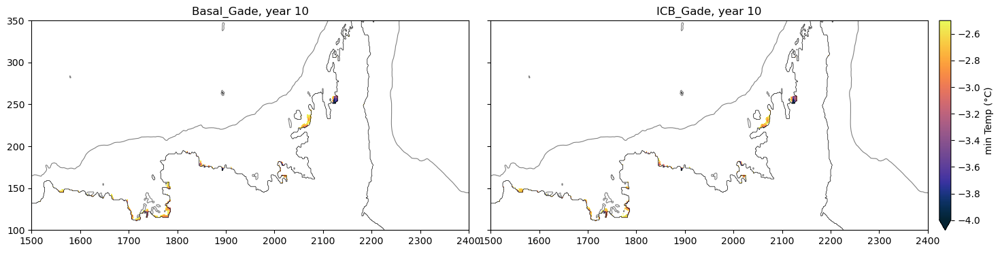

In [19]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(17,4), sharex=True, sharey=True)
plt.subplots_adjust(wspace=0.05)

axes[0].contour(ht_tmp,levels=[0,1.], zorder=2, colors='k', linewidths=0.5)
axes[0].contour(ht,levels=[1000], zorder=1, colors='grey', linewidths=0.8)
axes[0].pcolormesh(temp_basal_neg, zorder=0, cmap=cmo.cm.thermal, vmin=-4, vmax=-2.5)

axes[1].contour(ht_tmp,levels=[0,1.], zorder=2, colors='k', linewidths=0.5)
axes[1].contour(ht,levels=[1000], zorder=1, colors='grey', linewidths=0.8)
cb = axes[1].pcolormesh(temp_icb_neg, zorder=0, cmap=cmo.cm.thermal, vmin=-4, vmax=-2.5 )

cax = fig.add_axes([0.91, 0.11, 0.01, 0.77])
fig.colorbar(cb, cax=cax, orientation='vertical', extend='min',label='min Temp (°C)')

axes[0].set_title('Basal_Gade, year 10')
axes[1].set_title('ICB_Gade, year 10')

axes[1].set_xlim([1500,2400])
axes[1].set_ylim([100,350])

plt.show()

In [13]:
%%time
temp_icb_cold = temp_icb.where(temp_icb <= -2.5, np.nan).compute()
temp_basal_cold = temp_basal.where(temp_basal <= -2.5, np.nan).compute()

CPU times: user 29 s, sys: 15.5 s, total: 44.5 s
Wall time: 51.9 s


In [170]:
def figure(lon_min, lon_max, lat_min, lat_max):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,5))
    plt.subplots_adjust(wspace=0.1)
    
    axes[0].set_title('Basal Gade, no ICB', fontsize=14)
    axes[1].set_title('Basal + Iceberg Gade', fontsize=14)
    axes[0].set_ylabel('Latitude', fontsize=12)

    for i, ax in enumerate(axes.flatten()):
        ax.contour(ht_tmp.xt_ocean, ht_tmp.yt_ocean, ht_tmp,levels=[0,1.], colors='k', linewidths=0.9, zorder=2)
        ax.contour(ht.xt_ocean, ht.yt_ocean, ht, levels=np.arange(0,3000, 200), 
                    colors='grey', linewidths=0.5, zorder=2)
        ax.pcolormesh(ht_tmp.xt_ocean, ht_tmp.yt_ocean, ht_tmp.where(ht_tmp > 0),cmap='Greys', vmin=0.8, vmax=1.5, zorder=1)
        ax.set_ylim([lat_min,lat_max])
        ax.set_xlim([lon_min, lon_max])
        ax.set_xlabel('Longitude', fontsize=12)
        
    return fig, axes

def plot_colorbar(fig,axes_loc,cb_item,label):
    fontsize=12
    cbaxes = fig.add_axes(axes_loc)
    cbar = plt.colorbar(cb_item, cax = cbaxes, orientation = 'vertical',extend = 'both', shrink=0.5)
    cbar.set_label(label,fontsize=fontsize,labelpad=2)
    cbar.ax.tick_params(labelsize=14)
    return cbar

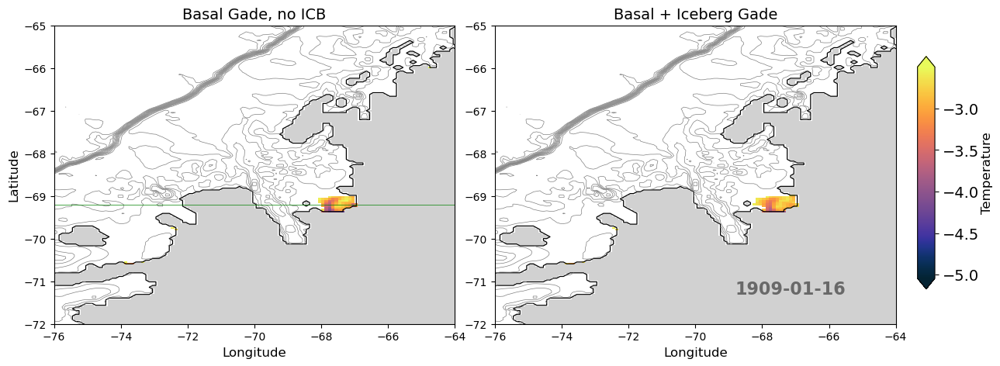

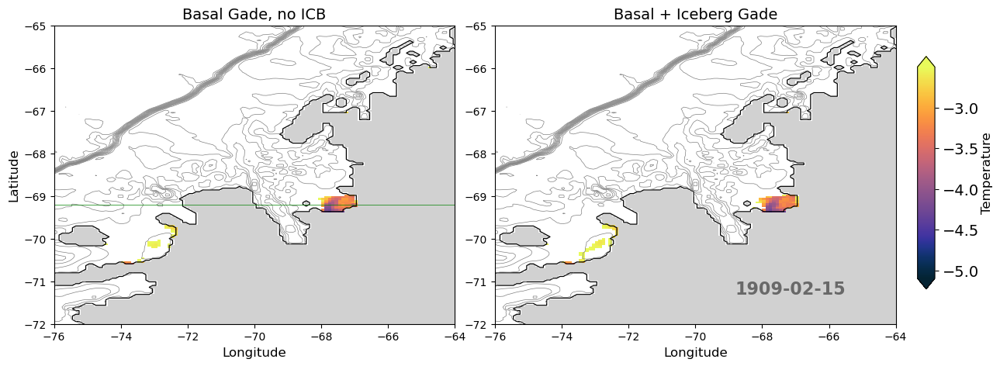

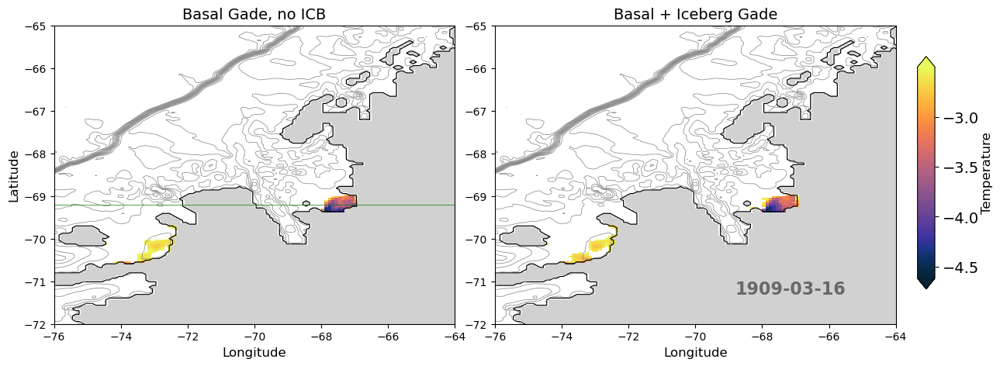

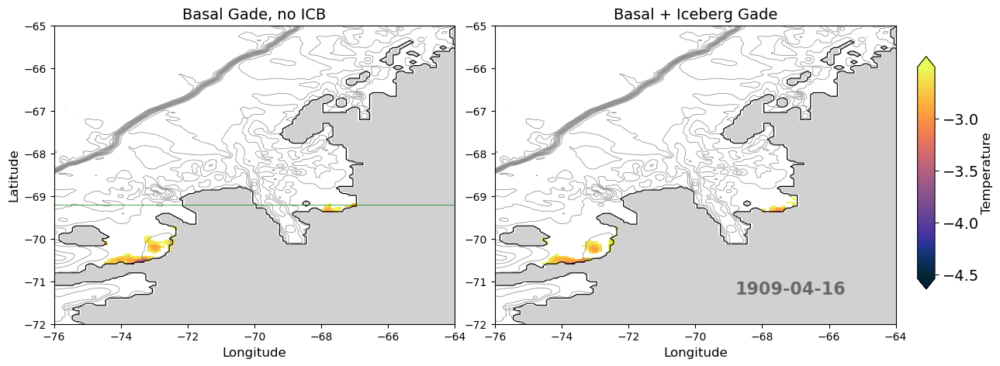

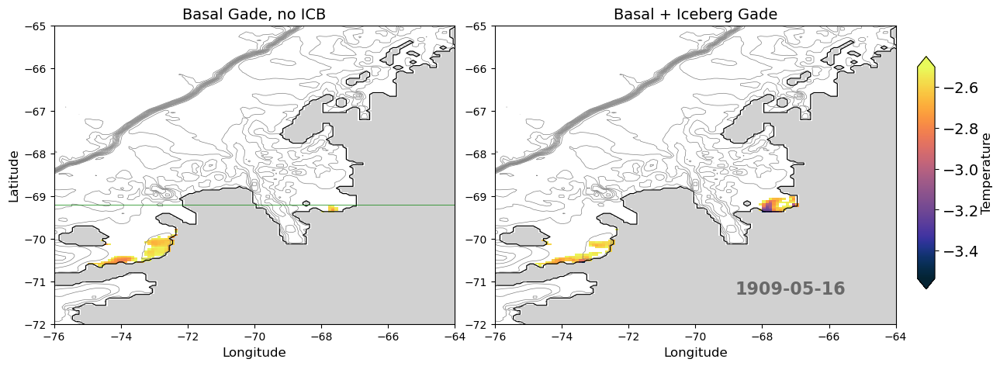

...

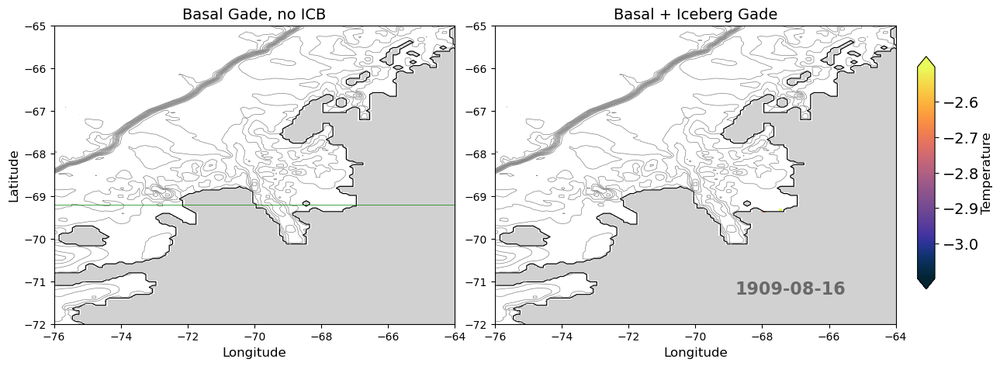

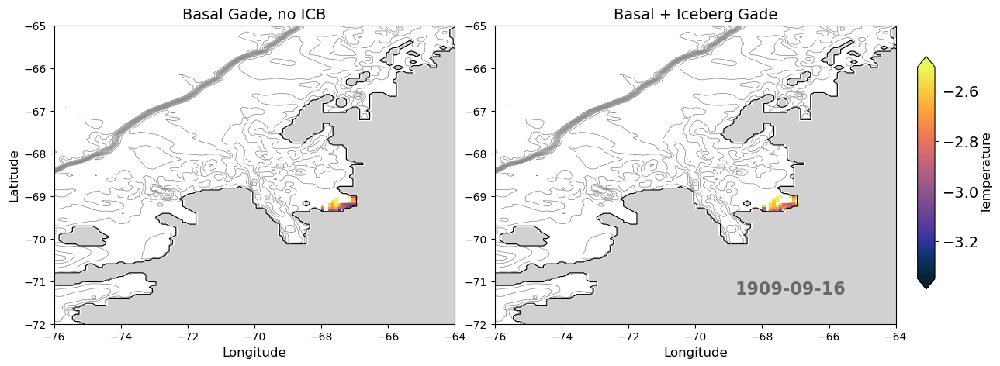

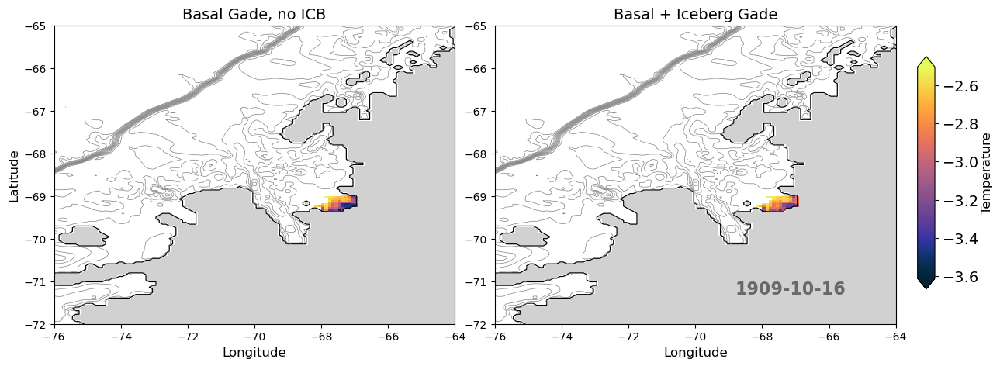

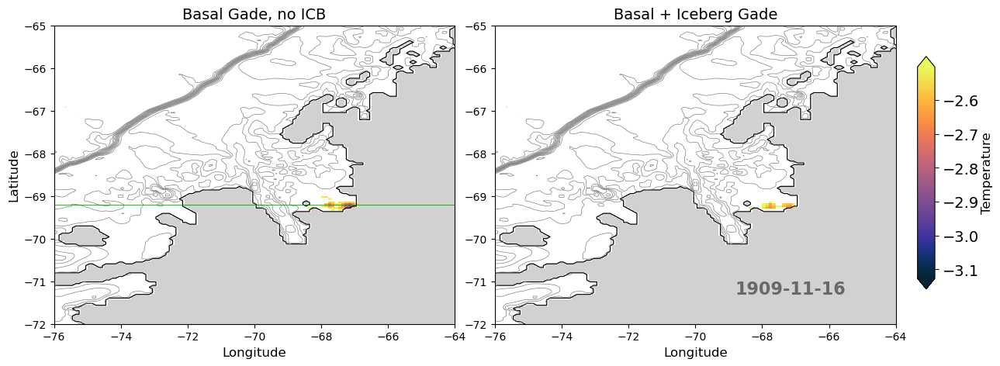

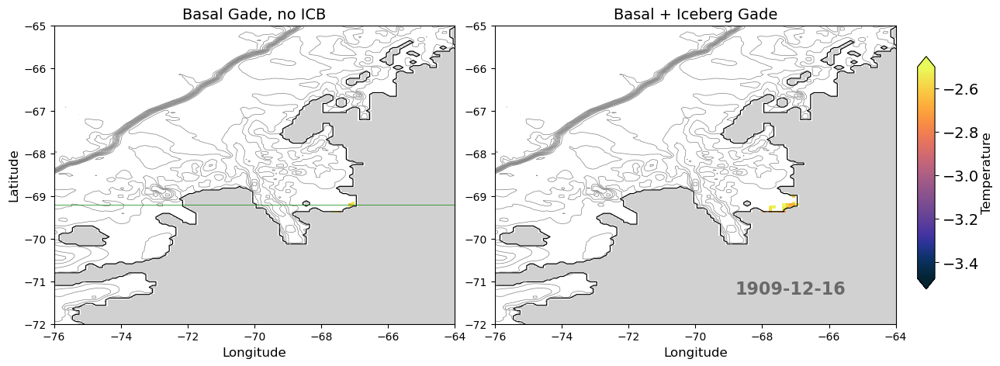

In [171]:
for t in range(12):
    fig, axes = figure(-76, -64, -72, -65)
    axes[0].pcolormesh(temp_basal_cold.xt_ocean, temp_basal_cold.yt_ocean, temp_basal_cold.min(dim='st_ocean').isel(time=t), zorder=1, cmap=cmo.cm.thermal)
    cb = axes[1].pcolormesh(temp_icb_cold.xt_ocean, temp_icb_cold.yt_ocean, temp_icb_cold.min(dim='st_ocean').isel(time=t), zorder=1, cmap=cmo.cm.thermal)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,'Temperature')
    axes[1].text(0.6, 0.1, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    axes[0].plot([-76,-64],[-69.2, -69.2], lw=0.5, ls='-',c='g')
    plt.show()

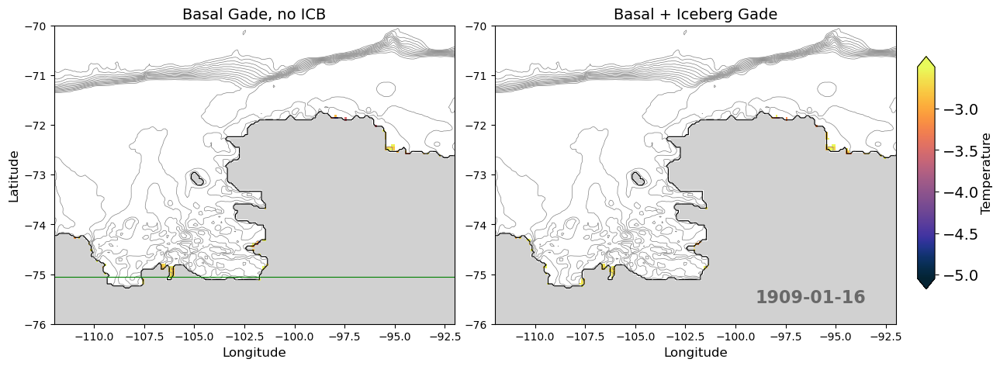

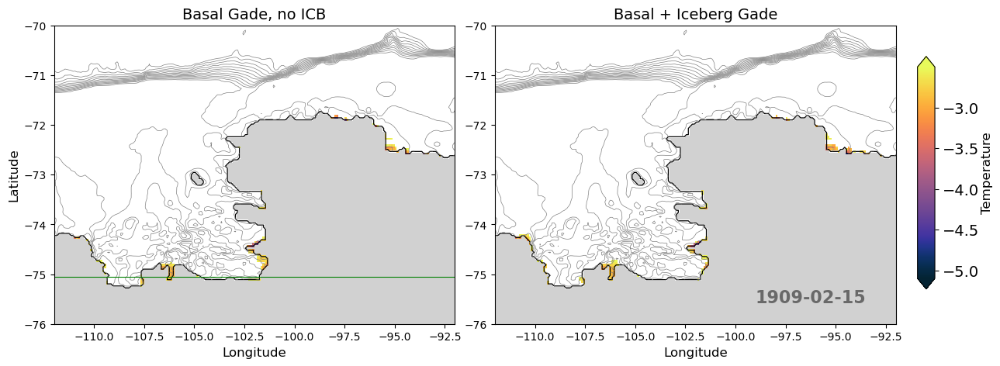

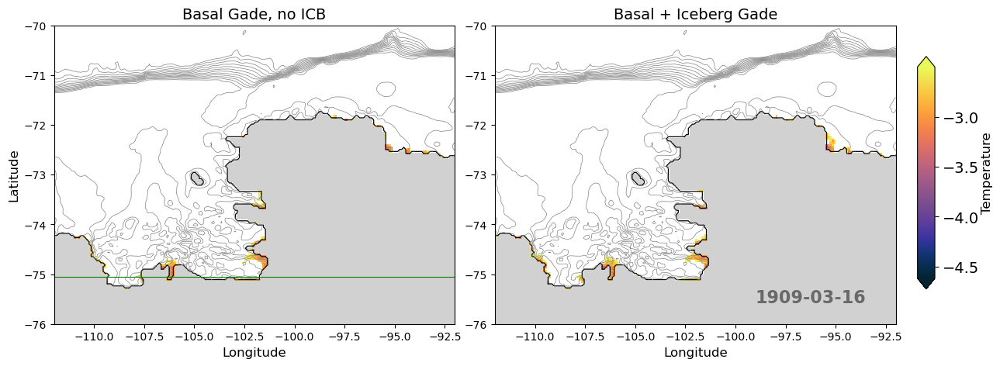

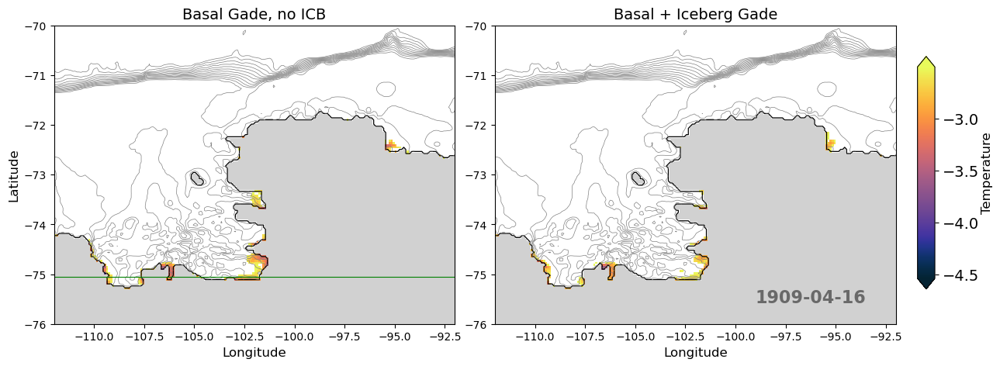

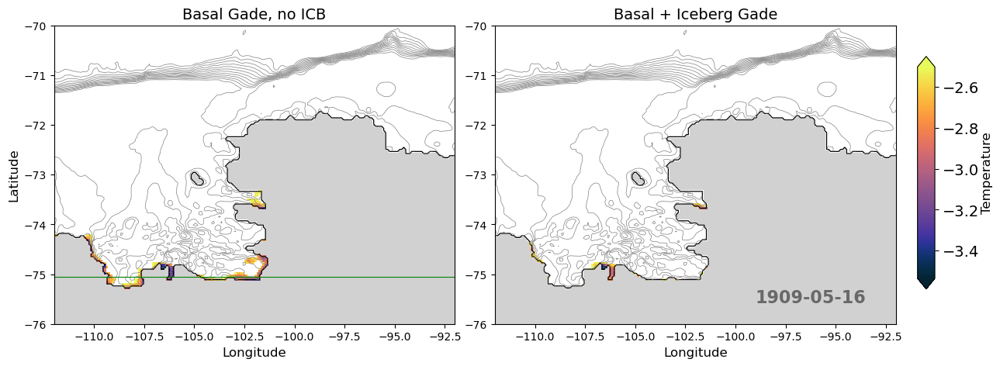

...

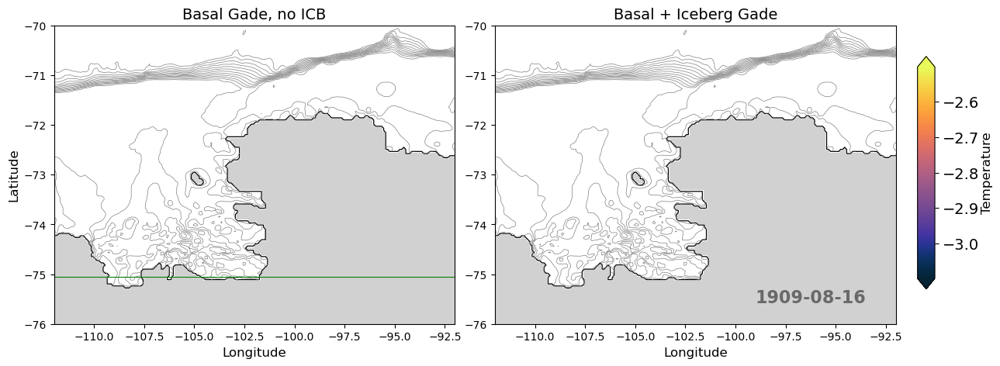

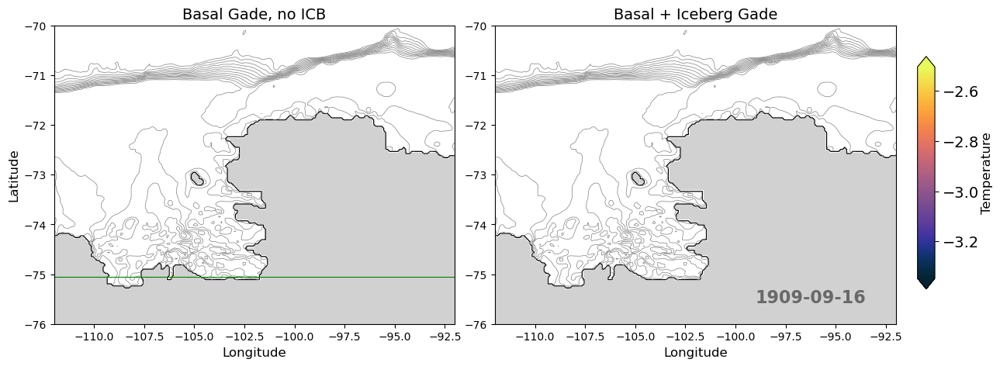

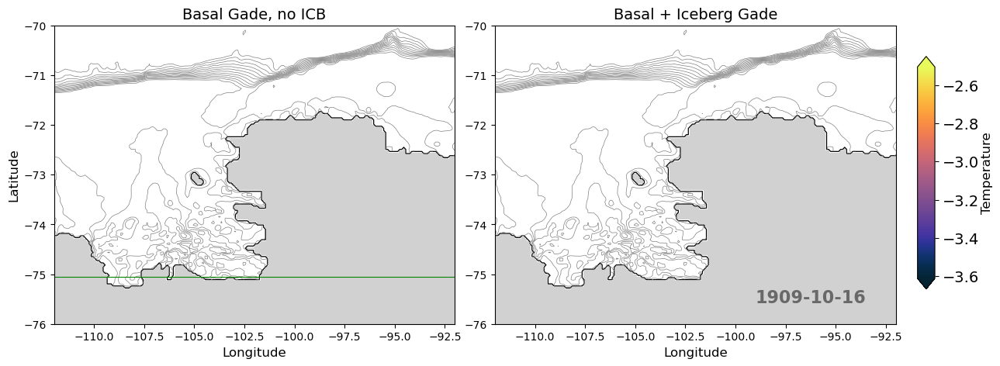

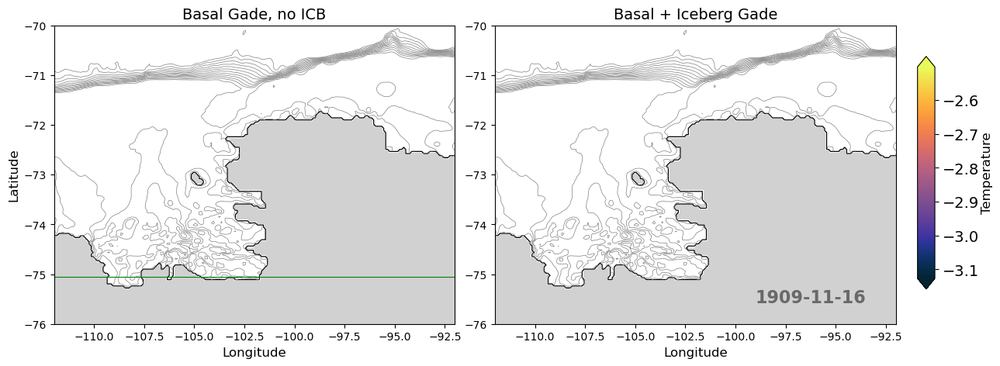

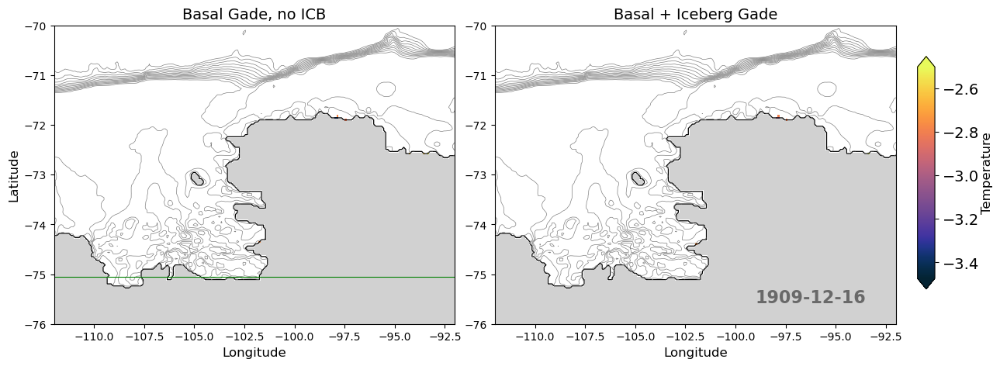

In [172]:
for t in range(12):
    fig, axes = figure(-112, -92, -76, -70)
    axes[0].pcolormesh(temp_basal_cold.xt_ocean, temp_basal_cold.yt_ocean, temp_basal_cold.min(dim='st_ocean').isel(time=t), zorder=1, cmap=cmo.cm.thermal)
    cb = axes[1].pcolormesh(temp_icb_cold.xt_ocean, temp_icb_cold.yt_ocean, temp_icb_cold.min(dim='st_ocean').isel(time=t), zorder=1, cmap=cmo.cm.thermal)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,'Temperature')
    axes[1].text(0.65, 0.07, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    axes[0].plot([-112,-92],[-75.05, -75.05], lw=0.8, ls='-',c='g')
    plt.show()

Now plotted by longitude. 

In [80]:
def figure_z(lon_min, lon_max, z_min, z_max):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,5))
    plt.subplots_adjust(wspace=0.1)
    
    axes[0].set_title('Basal Gade, no ICB', fontsize=14)
    axes[1].set_title('Basal + Iceberg Gade', fontsize=14)
    axes[0].set_ylabel('Depth (m)', fontsize=12)

    for i, ax in enumerate(axes.flatten()):
        ax.set_ylim([z_min,z_max])
        ax.invert_yaxis()
        ax.set_xlim([lon_min, lon_max])
        ax.set_xlabel('Longitude', fontsize=12)
        
    return fig, axes

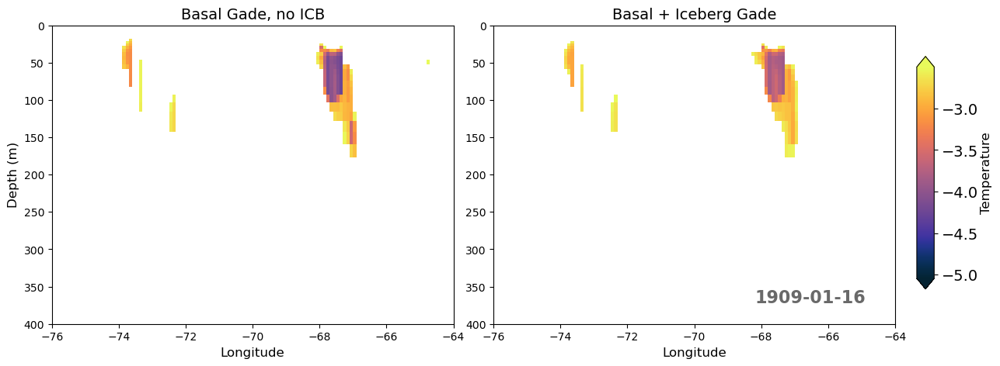

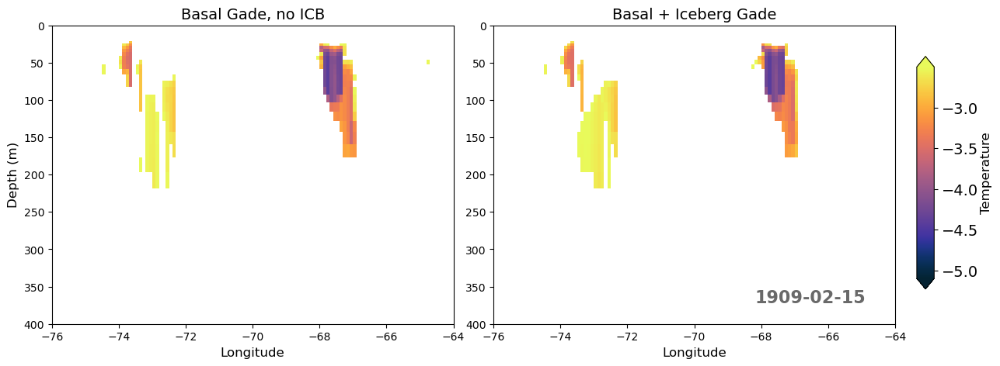

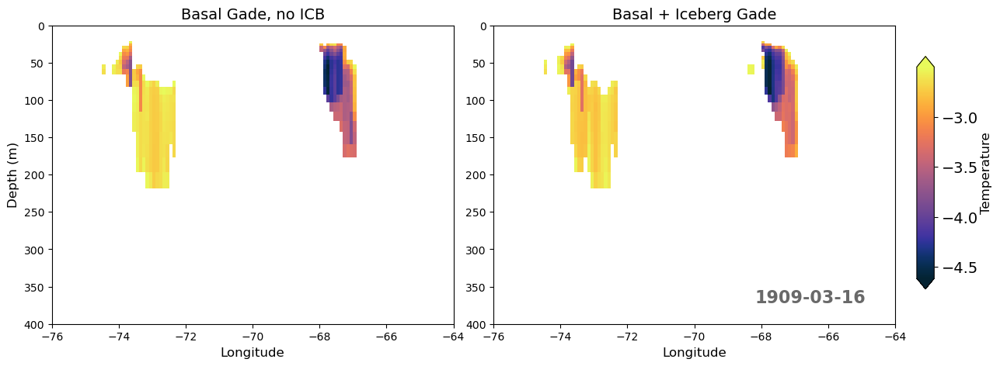

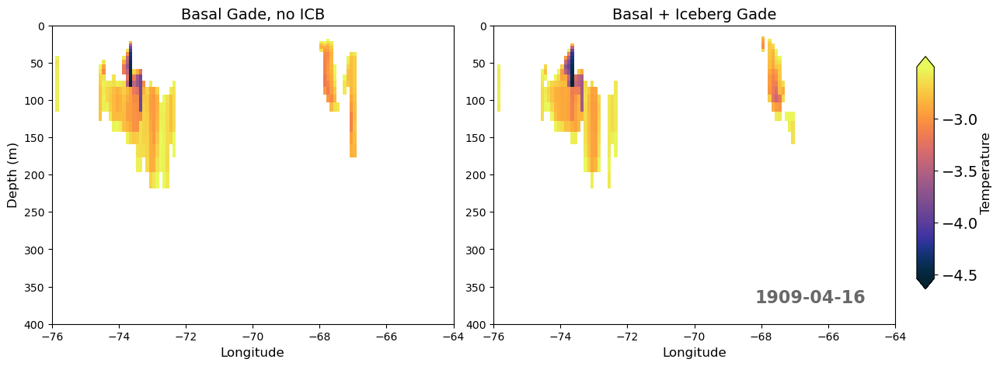

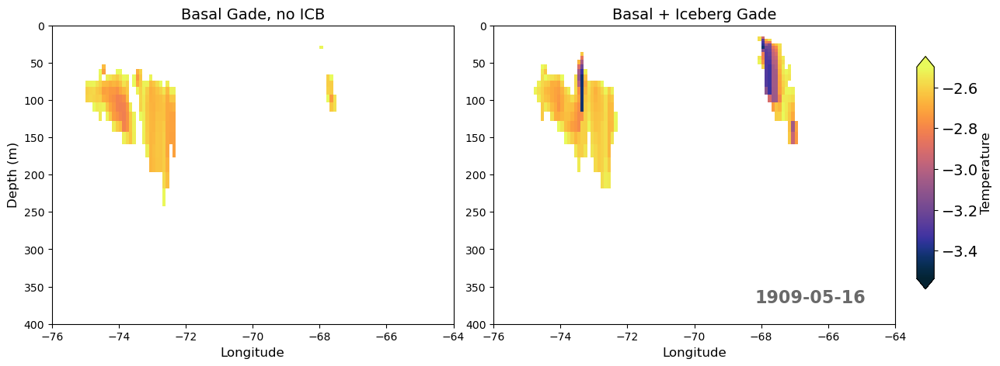

...

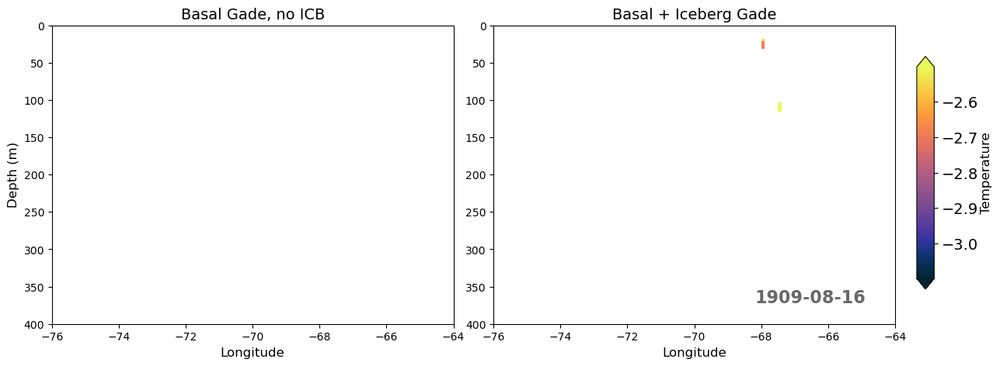

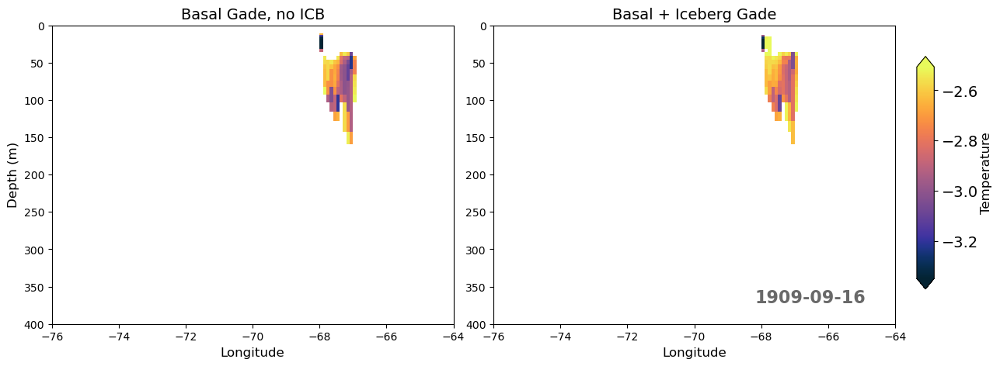

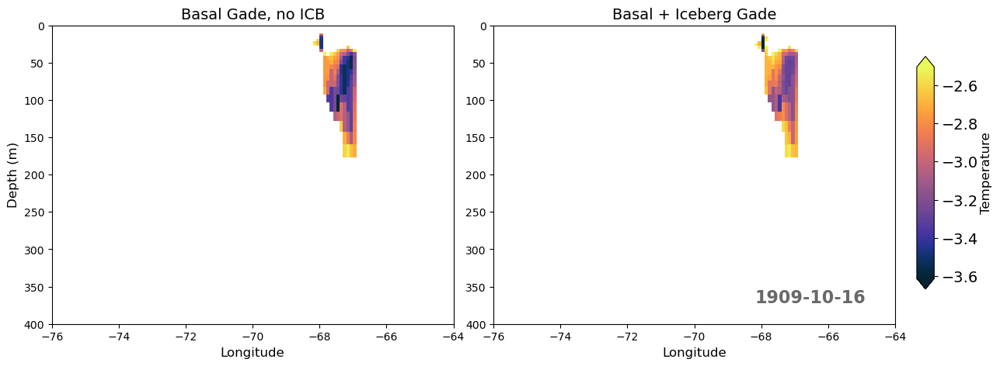

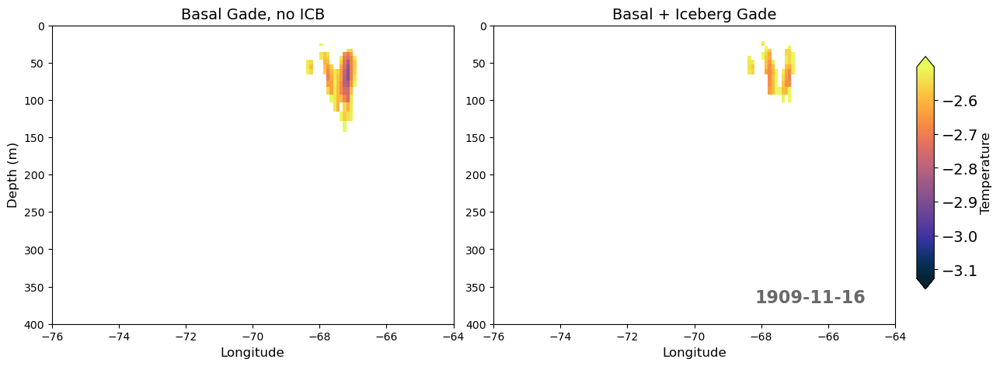

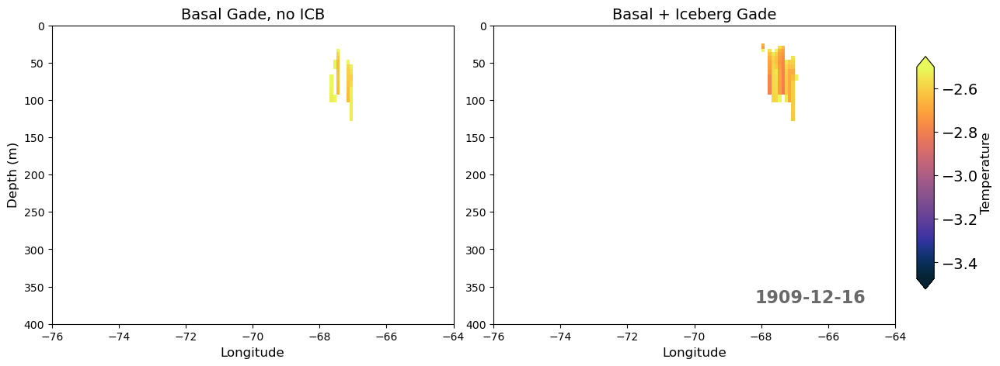

In [67]:
for t in range(12):
    fig, axes = figure_z(-76, -64, 0, 400)
    axes[0].pcolormesh(temp_basal_cold.xt_ocean, temp_basal_cold.st_ocean, temp_basal_cold.min(dim='yt_ocean').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    cb = axes[1].pcolormesh(temp_icb_cold.xt_ocean, temp_icb_cold.st_ocean, temp_icb_cold.min(dim='yt_ocean').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,'Temperature')
    axes[1].text(0.65, 0.07, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    plt.show()

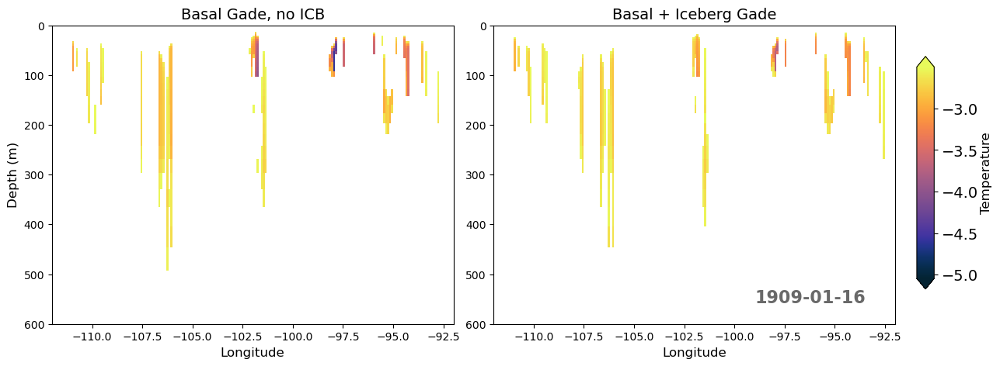

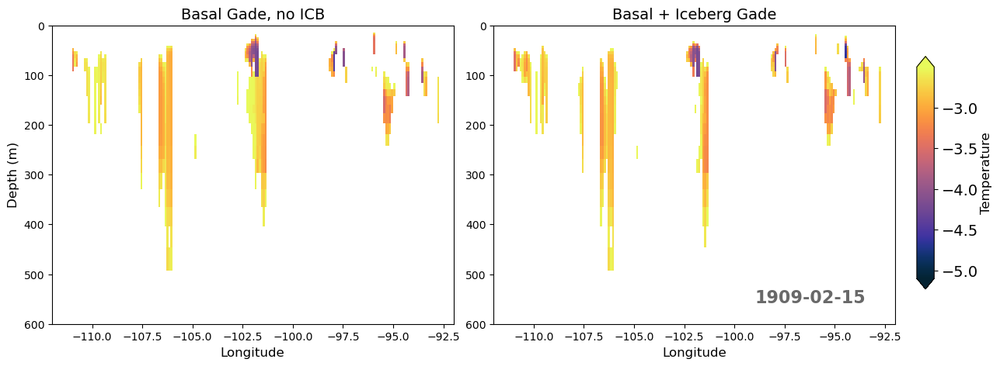

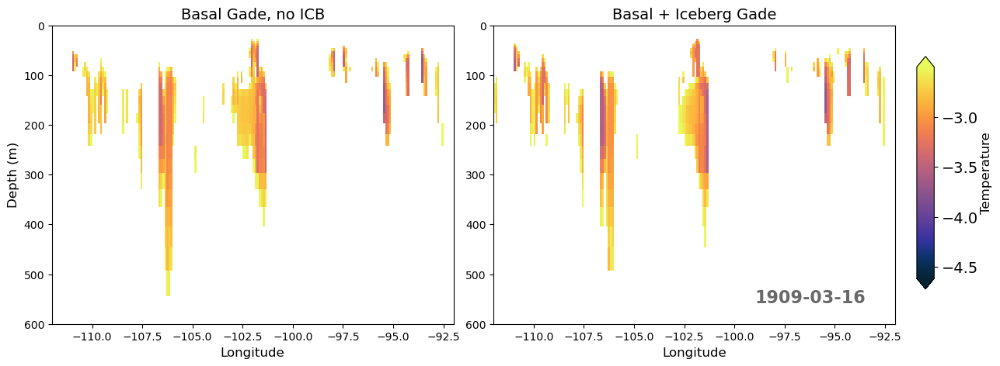

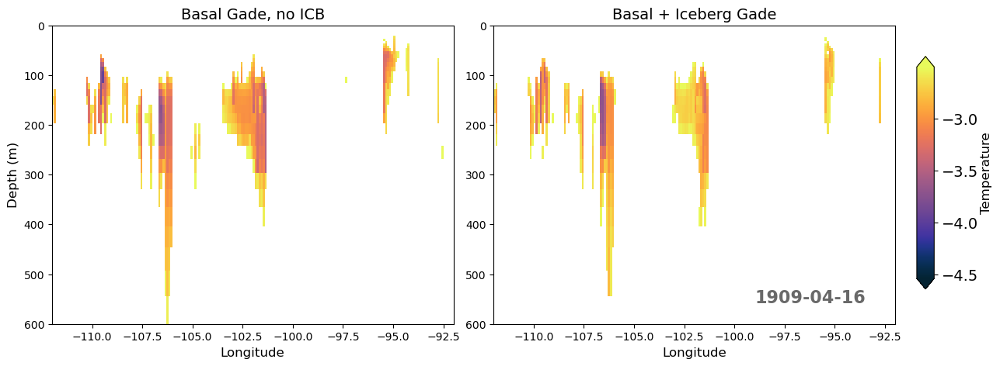

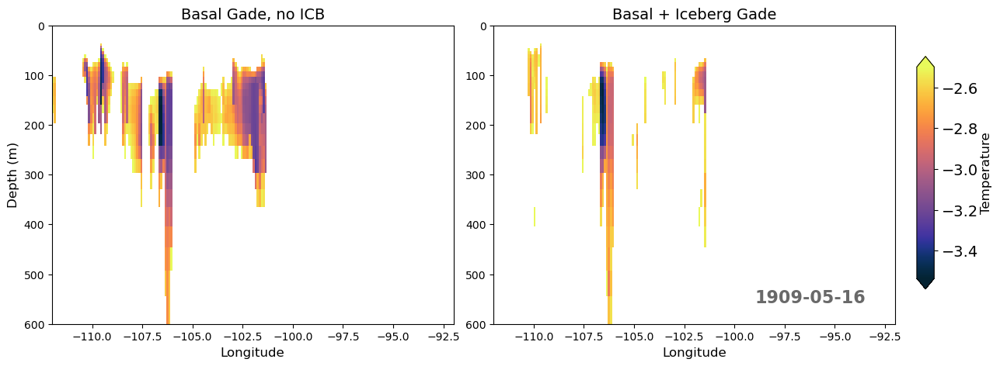

...

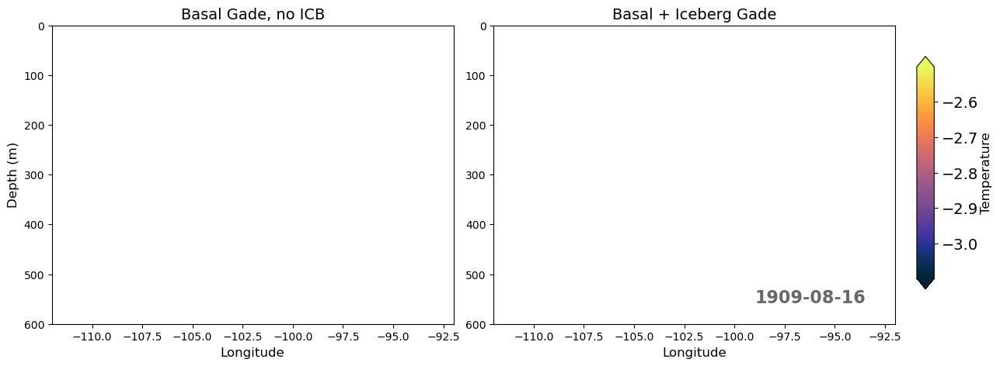

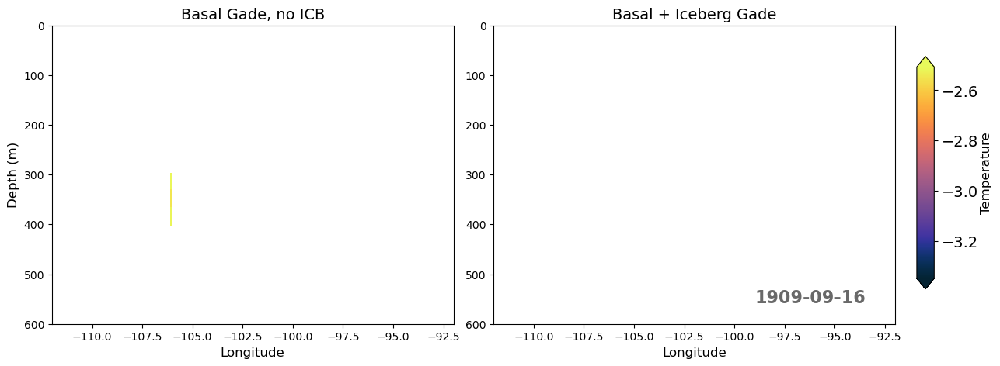

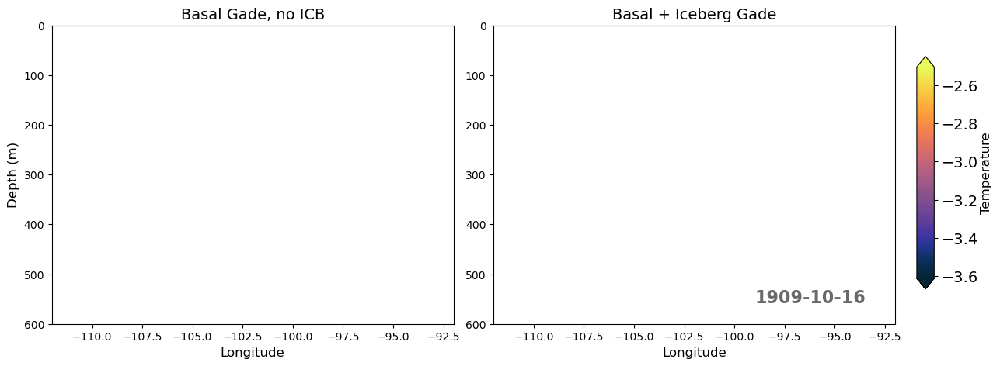

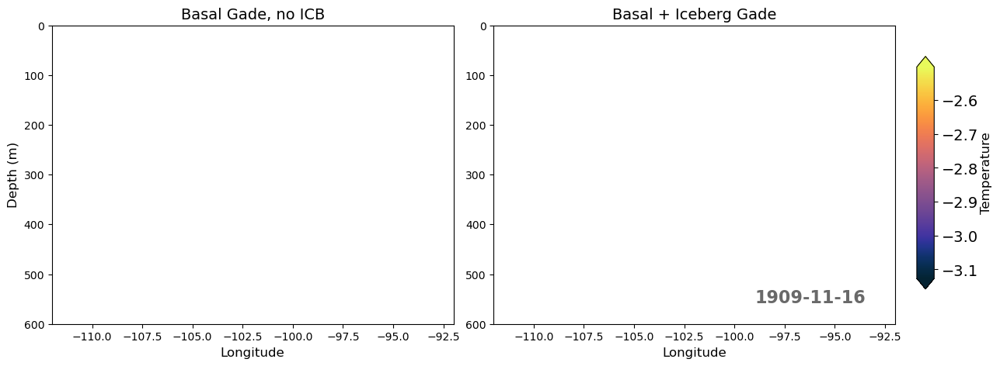

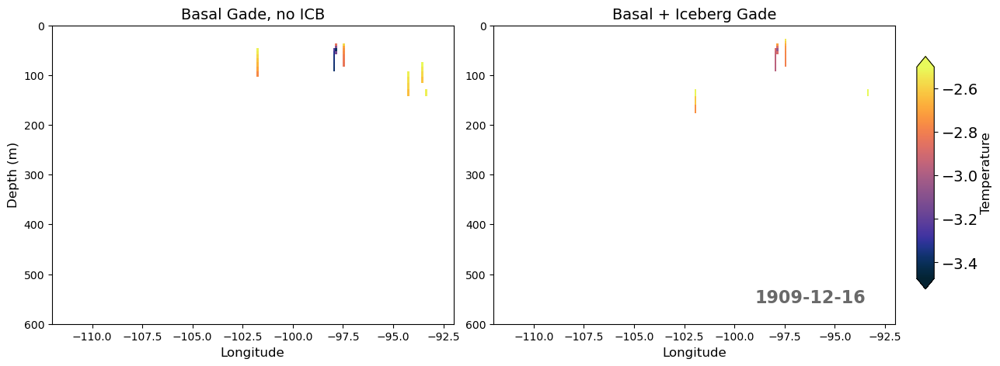

In [82]:
for t in range(12):
    fig, axes = figure_z(-112, -92, 0, 600)
    axes[0].pcolormesh(temp_basal_cold.xt_ocean, temp_basal_cold.st_ocean, temp_basal_cold.min(dim='yt_ocean').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    cb = axes[1].pcolormesh(temp_icb_cold.xt_ocean, temp_icb_cold.st_ocean, temp_icb_cold.min(dim='yt_ocean').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,'Temperature')
    axes[1].text(0.65, 0.07, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    plt.show()

In [182]:
def figure_z_ht(lon_min, lon_max, lat, z_min, z_max):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,5))
    plt.subplots_adjust(wspace=0.1)
    
    axes[0].set_title('Basal Gade, no ICB', fontsize=14)
    axes[1].set_title('Basal + Iceberg Gade', fontsize=14)
    axes[0].set_ylabel('Depth (m)', fontsize=12)

    for i, ax in enumerate(axes.flatten()):
        ax.plot(ht.xt_ocean, ht.sel(yt_ocean=lat, method='nearest').fillna(0.), color='k', lw=1.5, zorder=2)
        ax.fill_between(ht.xt_ocean, ht.sel(yt_ocean=lat, method='nearest').fillna(0.), 1000, color='lightgrey')
        ax.set_ylim([z_min,z_max])
        ax.invert_yaxis()
        ax.set_xlim([lon_min, lon_max])
        ax.set_xlabel('Longitude', fontsize=12)
        
    return fig, axes

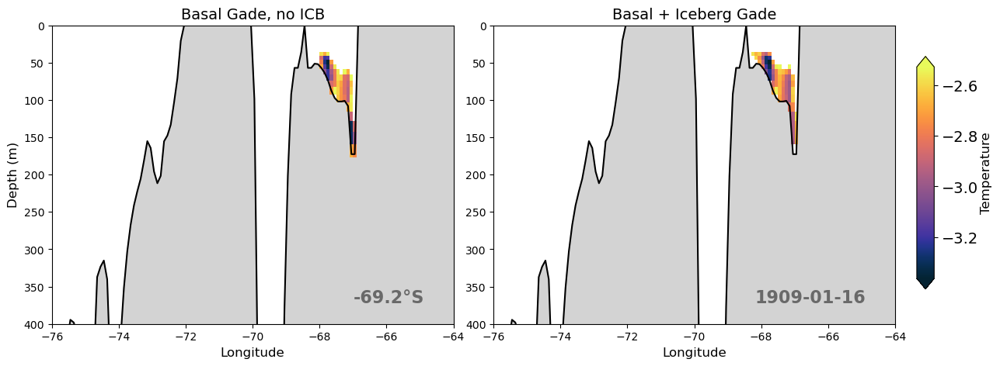

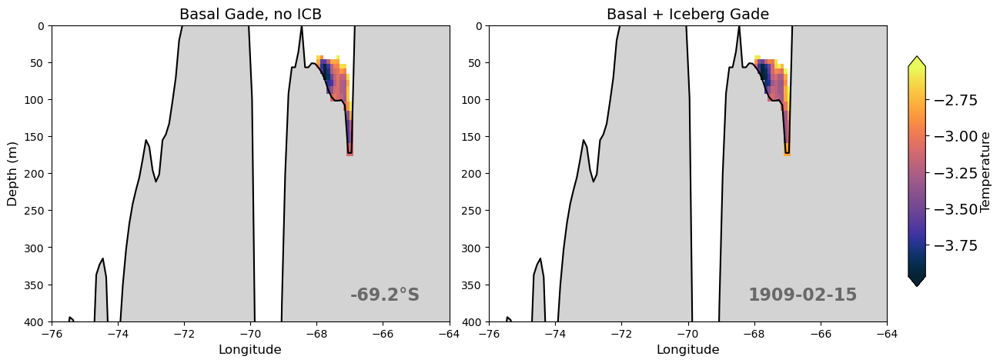

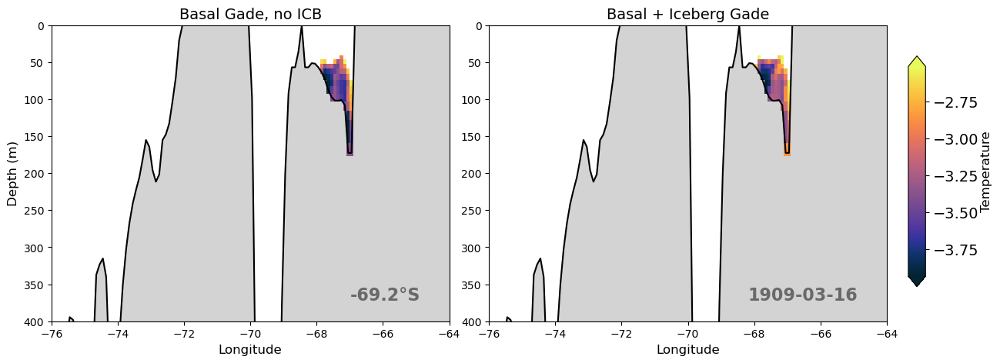

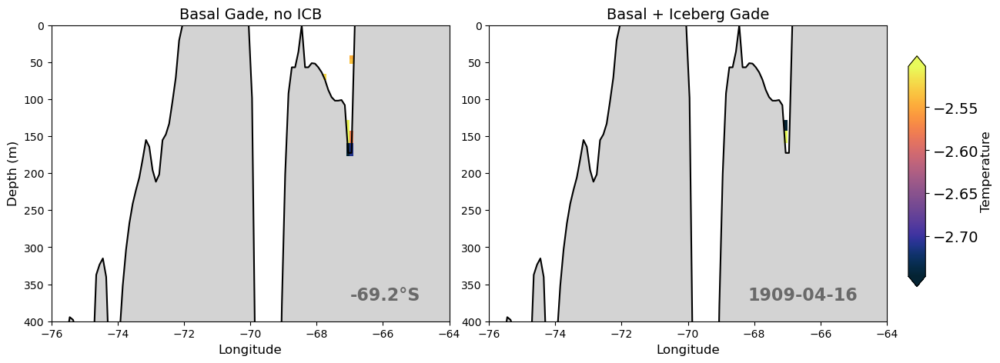

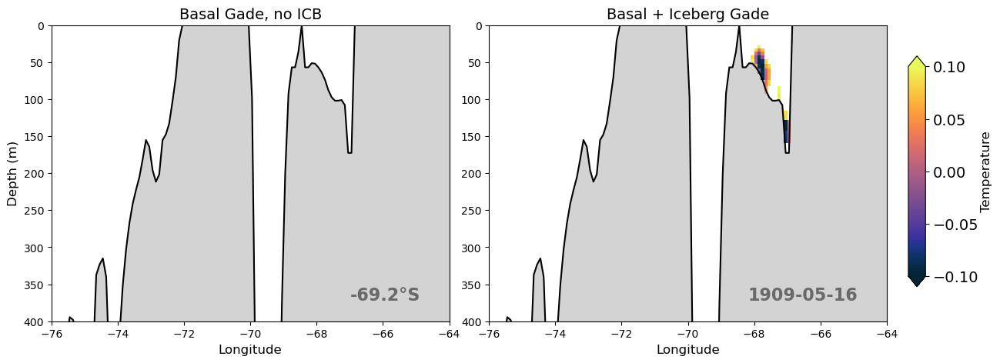

...

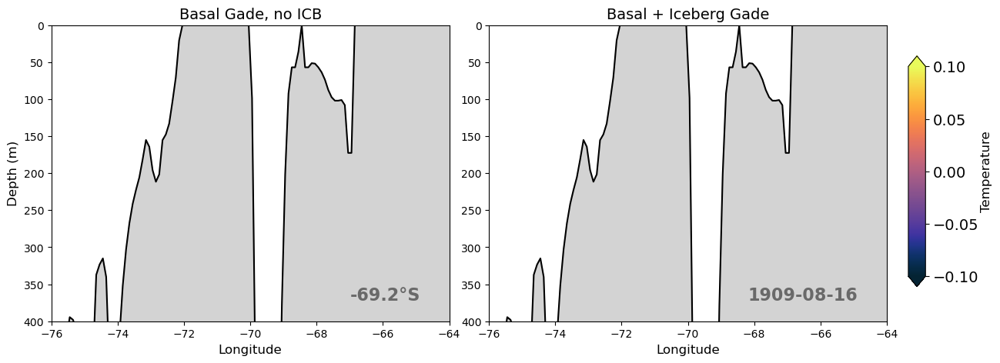

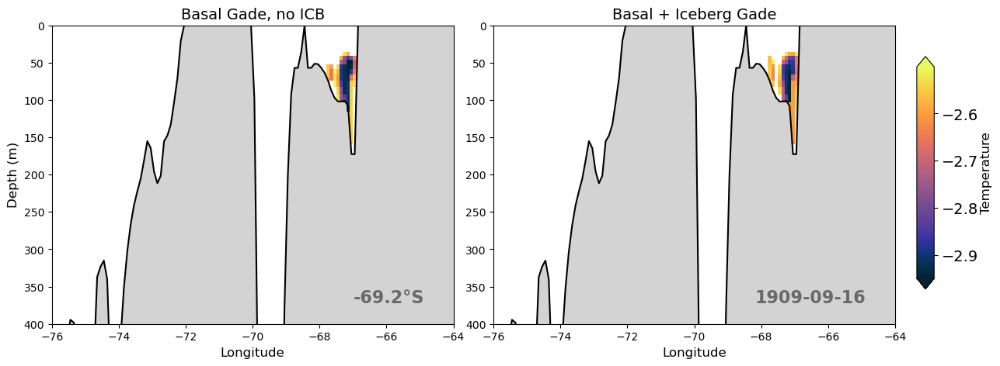

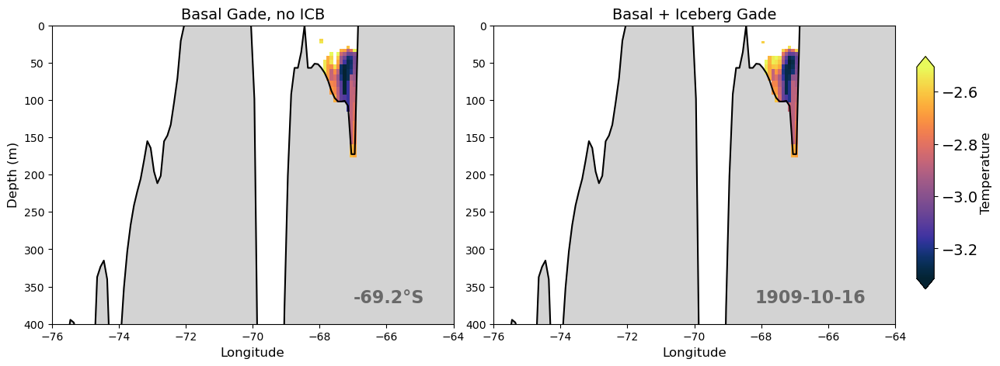

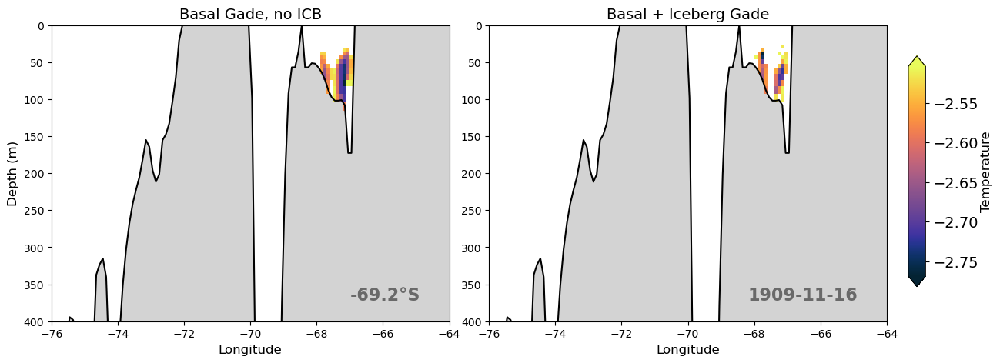

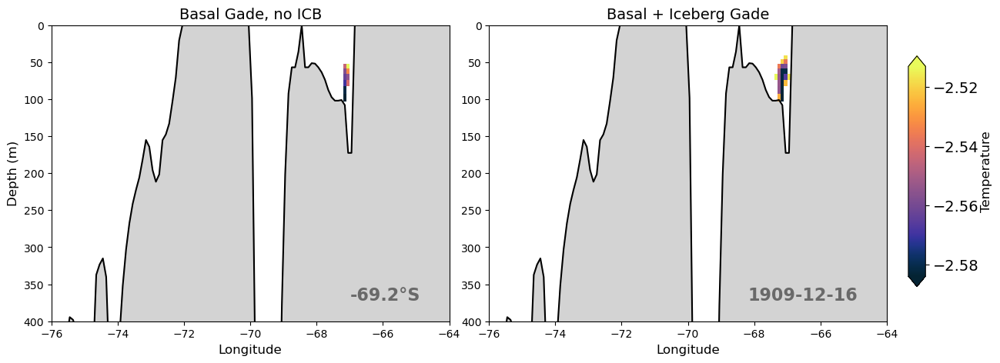

In [184]:
lat = -69.2
for t in range(12):
    fig, axes = figure_z_ht(-76, -64, lat, 0, 400)
    cb = axes[0].pcolormesh(temp_basal_cold.xt_ocean, temp_basal_cold.st_ocean, temp_basal_cold.sel(yt_ocean = lat, method='nearest').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    axes[1].pcolormesh(temp_icb_cold.xt_ocean, temp_icb_cold.st_ocean, temp_icb_cold.sel(yt_ocean = lat, method='nearest').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    axes[0].text(0.75, 0.07, f'{lat}\u00b0S', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[0].transAxes)
    axes[1].text(0.65, 0.07, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,'Temperature')
    plt.show()

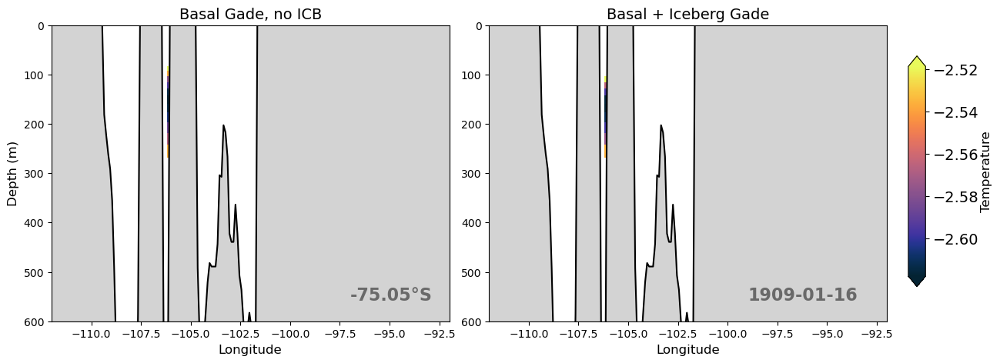

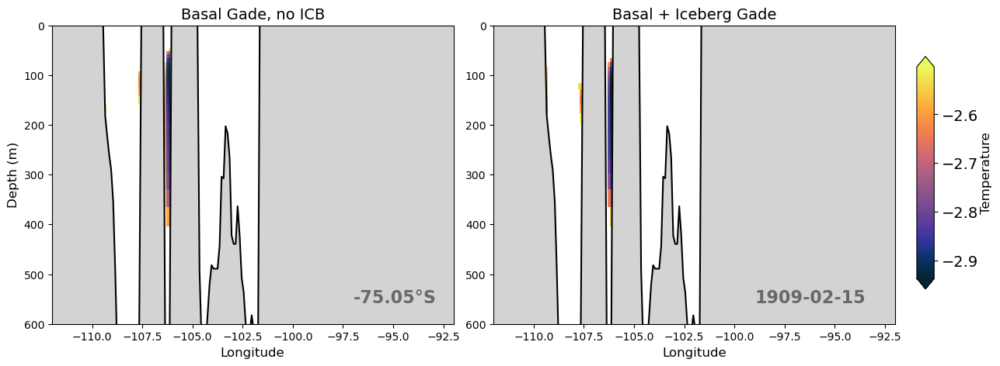

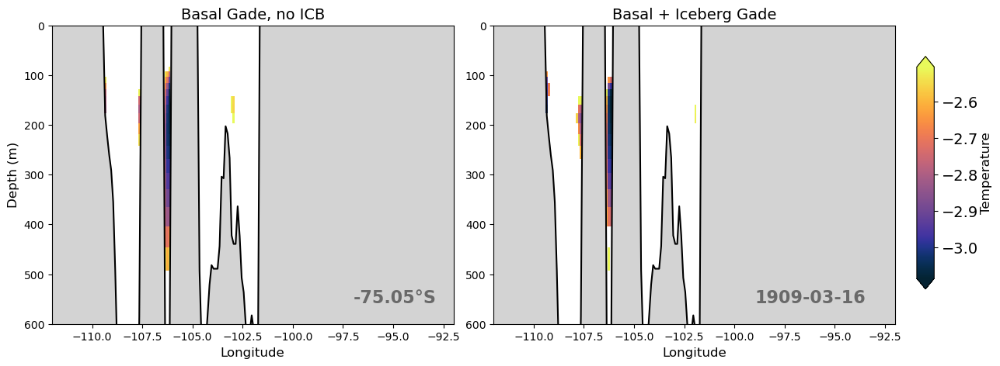

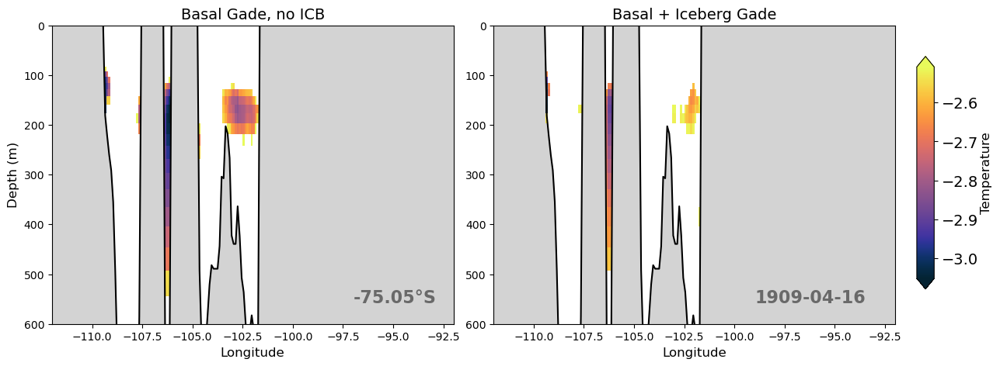

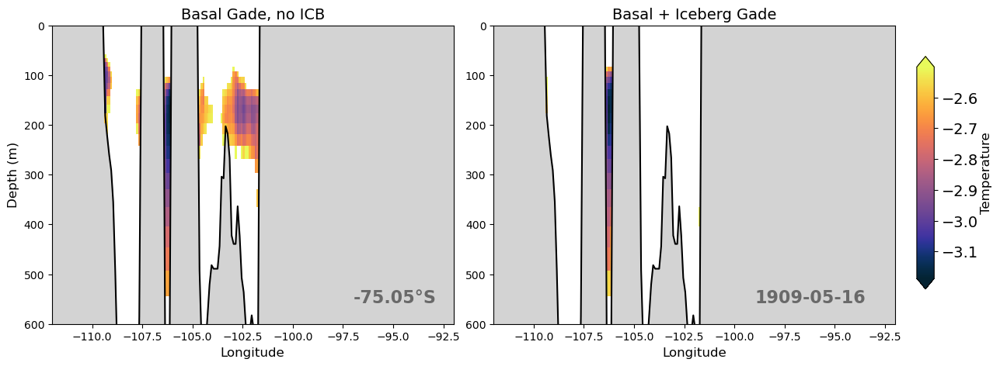

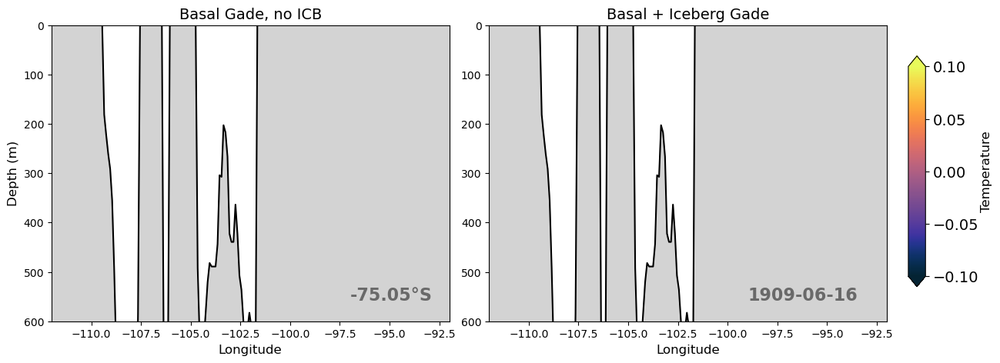

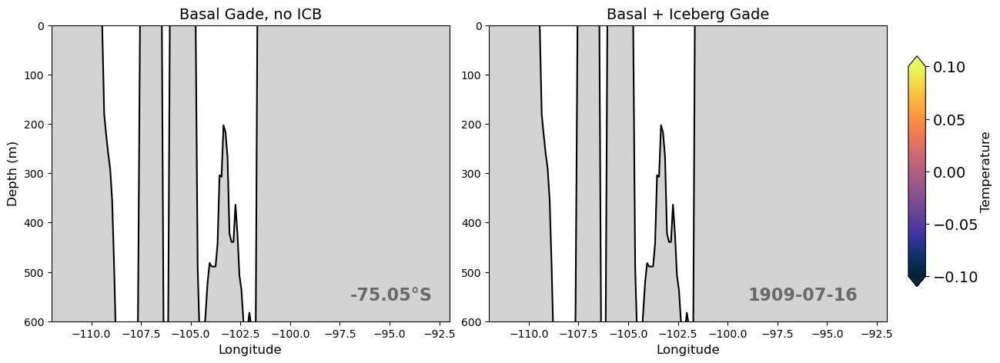

In [185]:
lat = -75.05
for t in range(7):
    fig, axes = figure_z_ht(-112, -92, lat, 0, 600)
    cb = axes[0].pcolormesh(temp_basal_cold.xt_ocean, temp_basal_cold.st_ocean, temp_basal_cold.sel(yt_ocean = lat, method='nearest').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    axes[1].pcolormesh(temp_icb_cold.xt_ocean, temp_icb_cold.st_ocean, temp_icb_cold.sel(yt_ocean = lat, method='nearest').isel(time=t), 
                       zorder=1, cmap=cmo.cm.thermal)
    axes[0].text(0.75, 0.07, f'{lat}\u00b0S', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[0].transAxes)
    axes[1].text(0.65, 0.07, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,'Temperature')
    plt.show()

#### Frazil investigation

In [124]:
frazil_3d_int_z_cntl = cc.querying.getvar(control, 'frazil_3d_int_z', master_session, 
                                          frequency='1 monthly',start_time=start_time, 
                                          end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)
frazil_3d_int_z_basal = cc.querying.getvar(basal_gade, 'frazil_3d_int_z', basal_melt_session, 
                                          frequency='1 monthly',start_time=start_time, 
                                          end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)
frazil_3d_int_z_icb = cc.querying.getvar(icb_gade, 'frazil_3d_int_z', basal_melt_session, 
                                          frequency='1 monthly',start_time=start_time, 
                                          end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)

In [228]:
frazil_3d_int_z_cntl

<xarray.DataArray 'frazil_3d_int_z' (time: 12, yt_ocean: 483, xt_ocean: 3600)>
dask.array<getitem, shape=(12, 483, 3600), dtype=float32, chunksize=(1, 483, 720), chunktype=numpy.ndarray>
Coordinates:
  * xt_ocean  (xt_ocean) float64 -279.9 -279.8 -279.7 ... 79.75 79.85 79.95
  * yt_ocean  (yt_ocean) float64 -79.97 -79.93 -79.88 ... -59.14 -59.08 -59.03
  * time      (time) object 1909-01-16 12:00:00 ... 1909-12-16 12:00:00
Attributes:
    long_name:      Vertical sum of ocn frazil heat flux over time step
    units:          W/m^2
    valid_range:    [-1.e+10  1.e+10]
    cell_methods:   time: mean
    time_avg_info:  average_T1,average_T2,average_DT
    coordinates:    geolon_t geolat_t
    ncfiles:        ['/g/data/v45/wf4500/outputs/access-om2-01/01deg_jra55v13...

In [231]:
def figure_frazil(lon_min, lon_max, lat_min, lat_max):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(16,4.5))
    plt.subplots_adjust(wspace=0.1)

    axes[0].set_title('Control', fontsize=14)
    axes[1].set_title('Basal Gade, no ICB', fontsize=14)
    axes[2].set_title('Basal + Iceberg Gade', fontsize=14)
    axes[0].set_ylabel('Latitude', fontsize=12)

    for i, ax in enumerate(axes.flatten()):
        ax.contour(ht_tmp.xt_ocean, ht_tmp.yt_ocean, ht_tmp,levels=[0,1.], colors='k', linewidths=0.9, zorder=2)
        ax.contour(ht.xt_ocean, ht.yt_ocean, ht, levels=np.arange(0,3000, 200), 
                    colors='grey', linewidths=0.5, zorder=2)
        ax.pcolormesh(ht_tmp.xt_ocean, ht_tmp.yt_ocean, ht_tmp.where(ht_tmp > 0),cmap='Greys', vmin=0.8, vmax=1.5, zorder=1)
        ax.set_ylim([lat_min,lat_max])
        ax.set_xlim([lon_min, lon_max])
        ax.set_xlabel('Longitude', fontsize=12)
        
    return fig, axes

def plot_colorbar(fig,axes_loc,cb_item,label):
    fontsize=12
    cbaxes = fig.add_axes(axes_loc)
    cbar = plt.colorbar(cb_item, cax = cbaxes, orientation = 'vertical',extend = 'max', shrink=0.5)
    cbar.set_label(label,fontsize=fontsize,labelpad=2)
    cbar.ax.tick_params(labelsize=14)
    return cbar

0.64082474 1995.9519 4126.6216


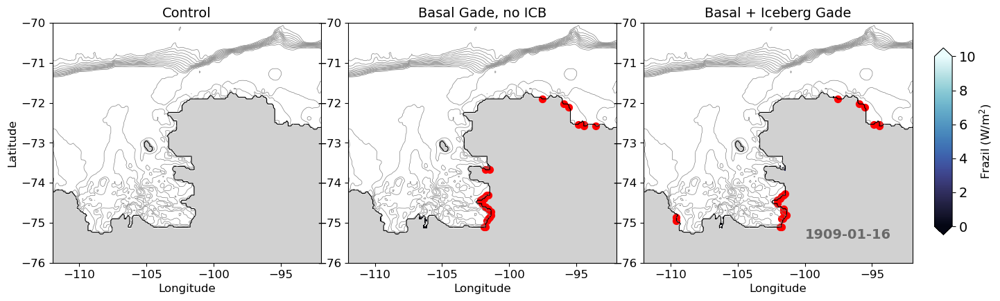

32.9523 1883.6628 1417.0121


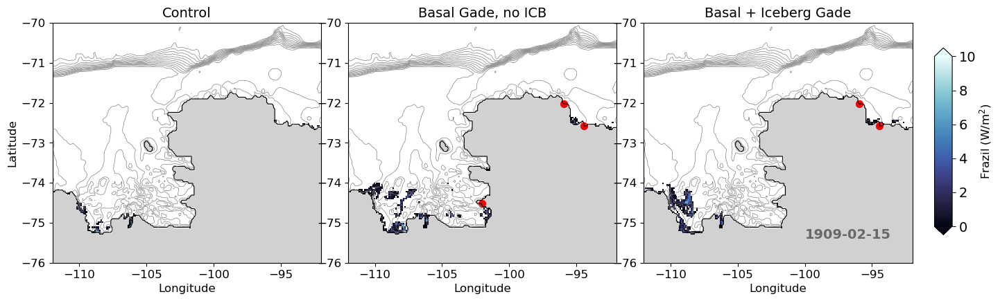

151.701 4977.602 2497.219


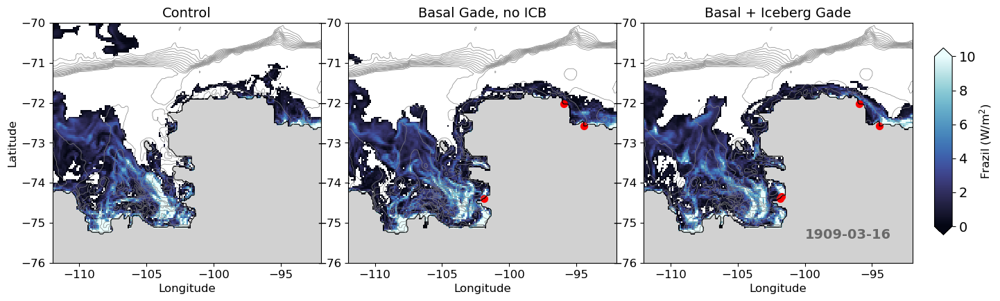

181.3105 5347.11 4980.6133


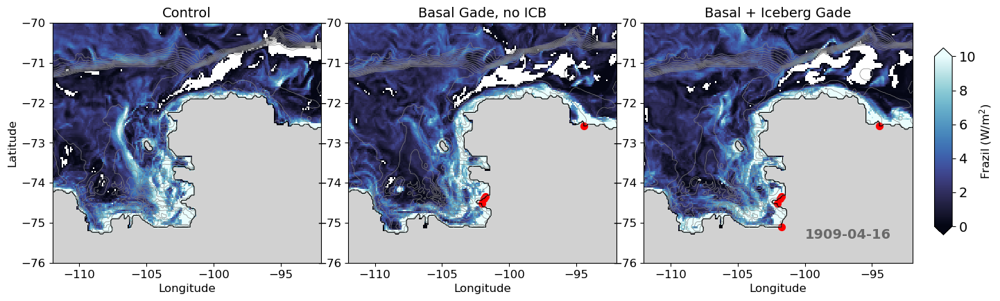

226.85796 5381.014 7021.7534


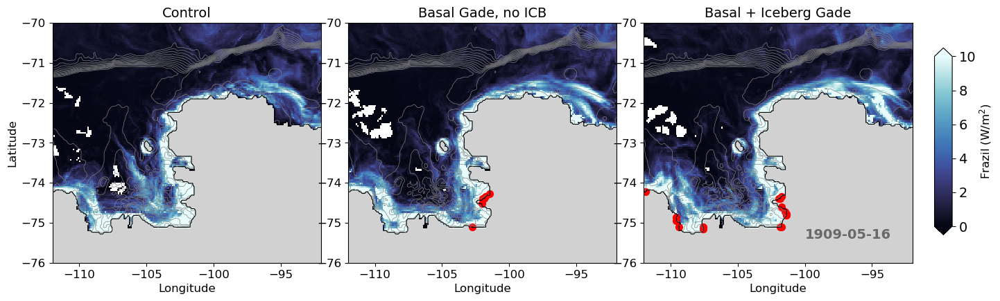

215.78986 5562.576 6697.211


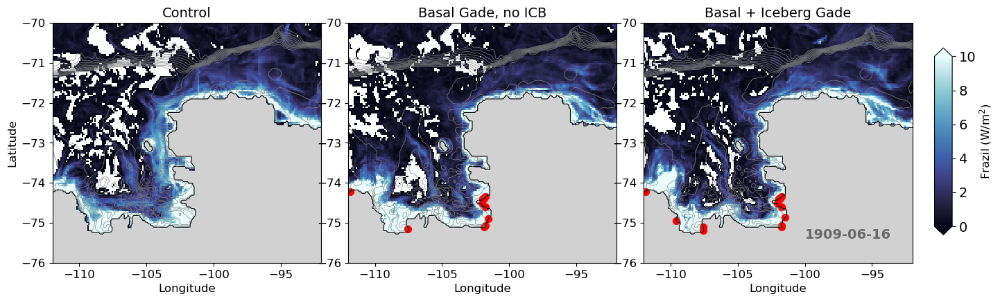

256.80914 5612.1094 6166.1865


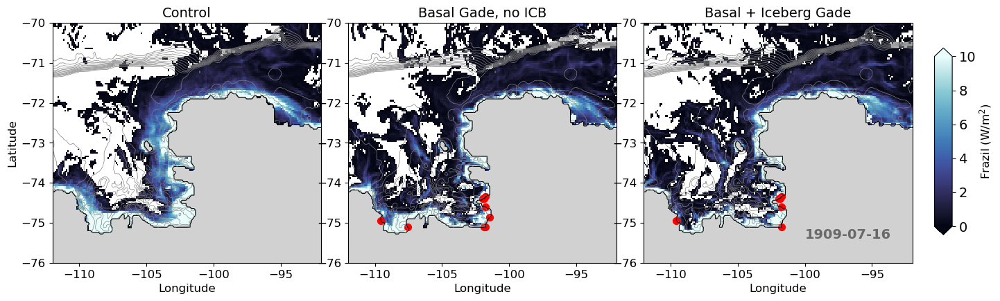

248.77724 5599.5884 6109.644


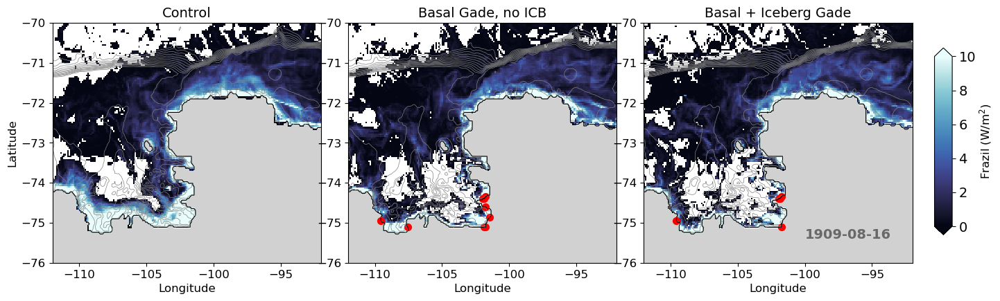

164.24832 5154.37 6081.924


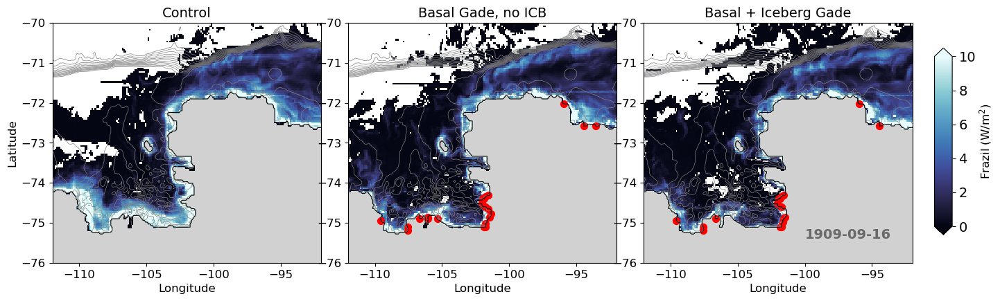

200.92545 5200.8374 6644.8667


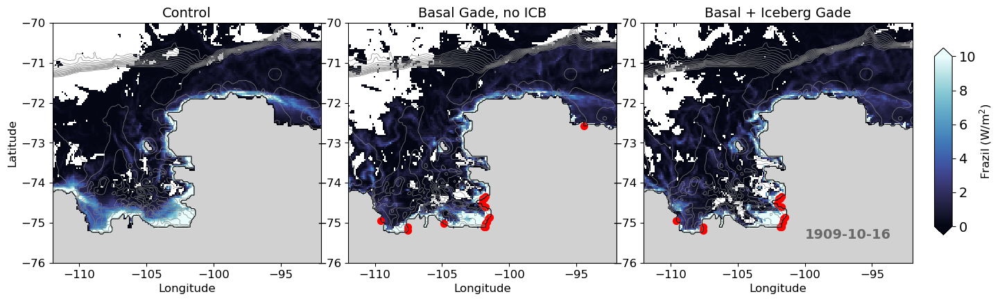

129.584 5359.144 7033.7607


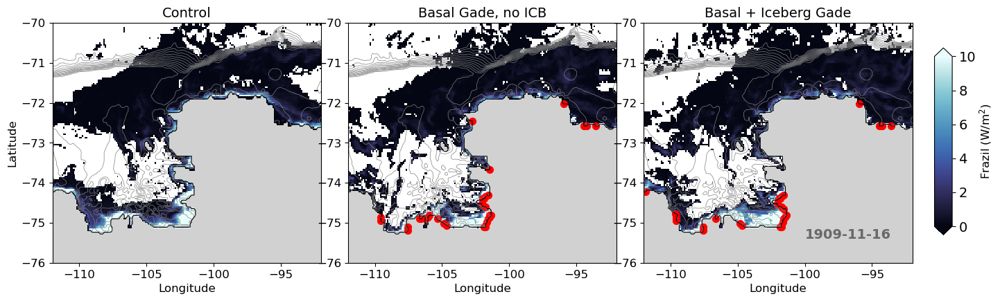

9.45964 5069.68 5675.7993


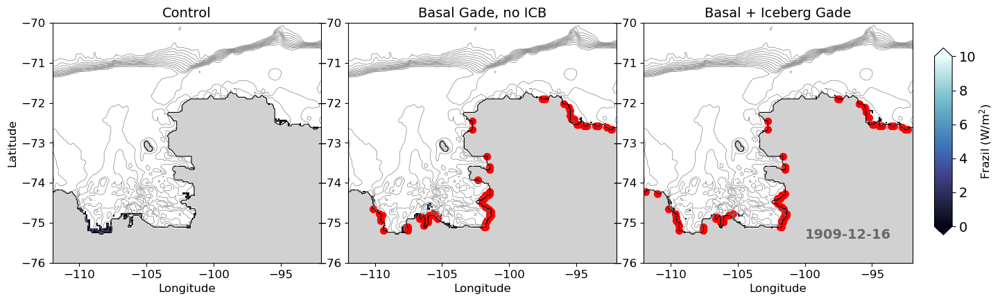

In [220]:
vmax = 10
for t in range(12):
    max_frazil = frazil_3d_int_z_cntl.isel(time=t).max().values
    print(max_frazil, frazil_3d_int_z_basal.isel(time=t).max().values, frazil_3d_int_z_icb.isel(time=t).max().values)
    frazil_mag = max_frazil*10
    fig, axes = figure_frazil(-112, -92, -76, -70)
    axes[0].pcolormesh(frazil_3d_int_z_cntl.xt_ocean, frazil_3d_int_z_cntl.yt_ocean, 
                       frazil_3d_int_z_cntl.isel(time=t).where(frazil_3d_int_z_cntl.isel(time=t) >0), 
                       zorder=1, cmap=cmo.cm.ice, vmin=0, vmax=vmax)
    axes[1].pcolormesh(frazil_3d_int_z_basal.xt_ocean, frazil_3d_int_z_basal.yt_ocean, 
                       frazil_3d_int_z_basal.isel(time=t).where(frazil_3d_int_z_basal.isel(time=t) >0), 
                       zorder=1, cmap=cmo.cm.ice, vmin=0, vmax=vmax)
    cb = axes[2].pcolormesh(frazil_3d_int_z_icb.xt_ocean, frazil_3d_int_z_icb.yt_ocean, 
                       frazil_3d_int_z_icb.isel(time=t).where(frazil_3d_int_z_icb.isel(time=t) >0), 
                       zorder=1, cmap=cmo.cm.ice, vmin=0, vmax=vmax)
    loc_indexes = np.where(frazil_3d_int_z_cntl.isel(time=t) > frazil_mag)
    axes[0].scatter(frazil_3d_int_z_cntl.xt_ocean[loc_indexes[1]], frazil_3d_int_z_cntl.yt_ocean[loc_indexes[0]], 
                    c ='r', s=50)
    loc_indexes = np.where(frazil_3d_int_z_basal.isel(time=t) > frazil_mag)
    axes[1].scatter(frazil_3d_int_z_basal.xt_ocean[loc_indexes[1]], frazil_3d_int_z_basal.yt_ocean[loc_indexes[0]], 
                    c ='r', s=50)
    loc_indexes = np.where(frazil_3d_int_z_icb.isel(time=t) > frazil_mag)
    axes[2].scatter(frazil_3d_int_z_icb.xt_ocean[loc_indexes[1]], frazil_3d_int_z_icb.yt_ocean[loc_indexes[0]], 
                    c ='r', s=50)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,f'Frazil (W/m$^2$)')
    axes[2].text(0.6, 0.1, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=14, fontweight='bold', color='dimgrey', transform=axes[2].transAxes)
    plt.show()

0.64082474 1995.9519 4126.6216


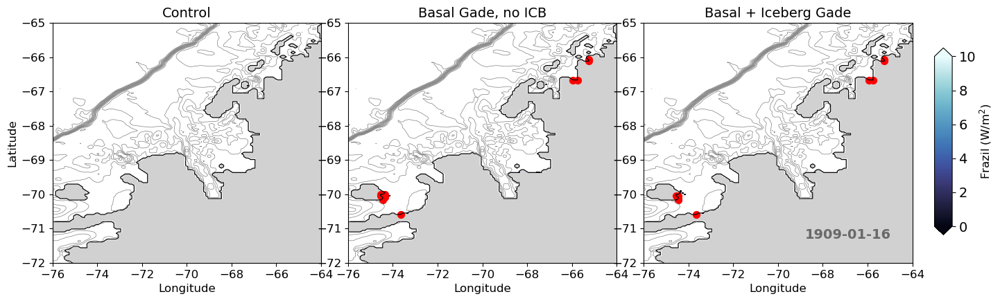

32.9523 1883.6628 1417.0121


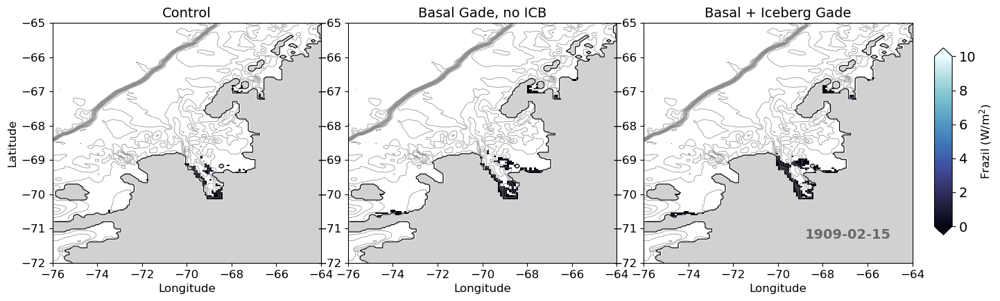

151.701 4977.602 2497.219


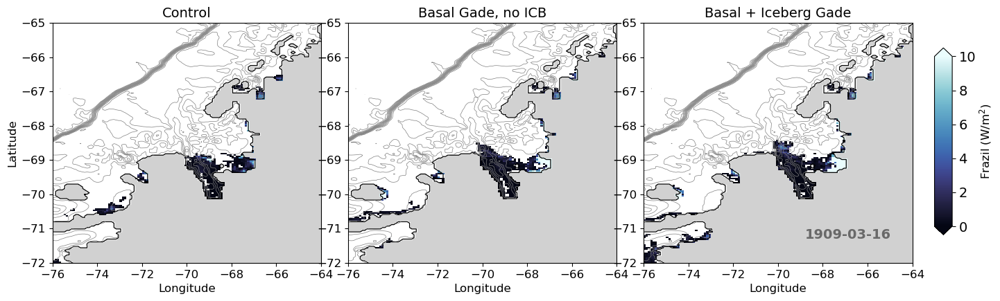

181.3105 5347.11 4980.6133


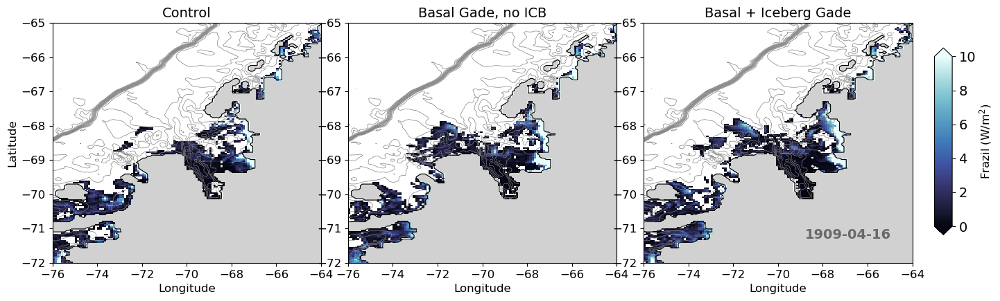

226.85796 5381.014 7021.7534


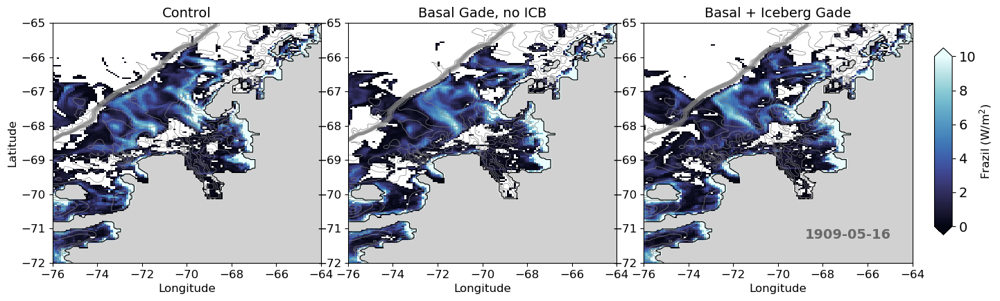

215.78986 5562.576 6697.211


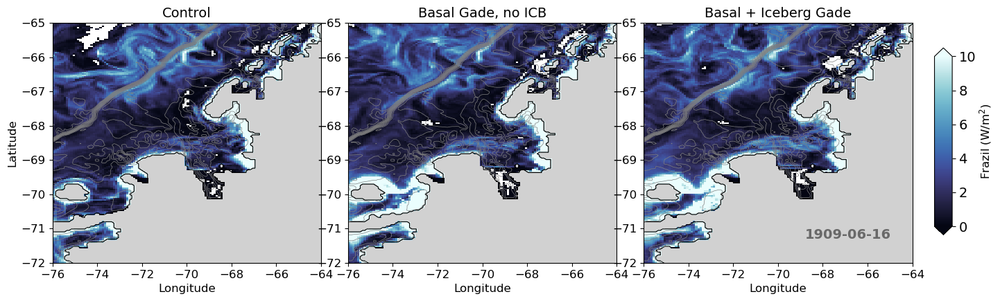

256.80914 5612.1094 6166.1865


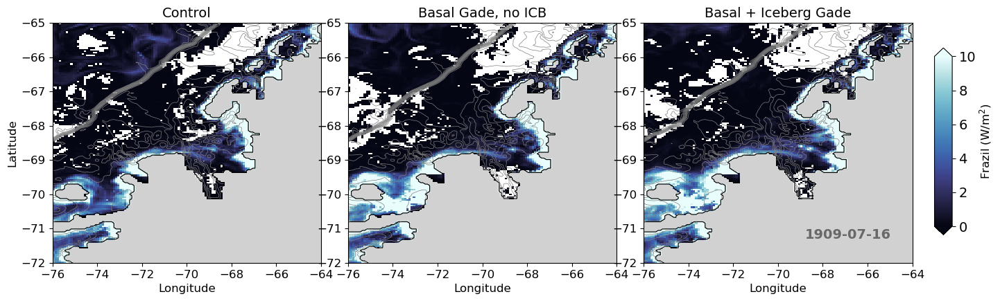

248.77724 5599.5884 6109.644


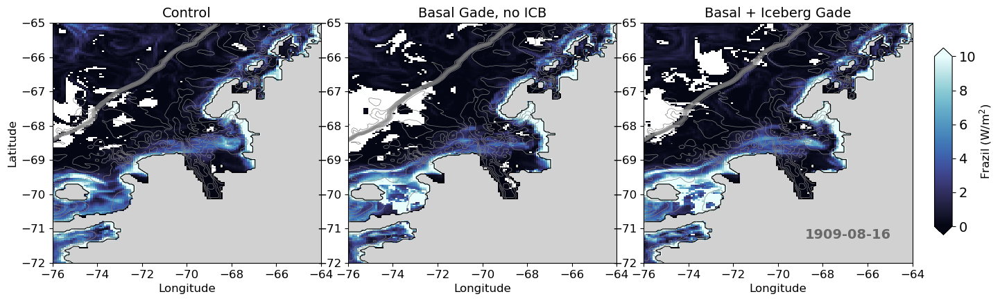

164.24832 5154.37 6081.924


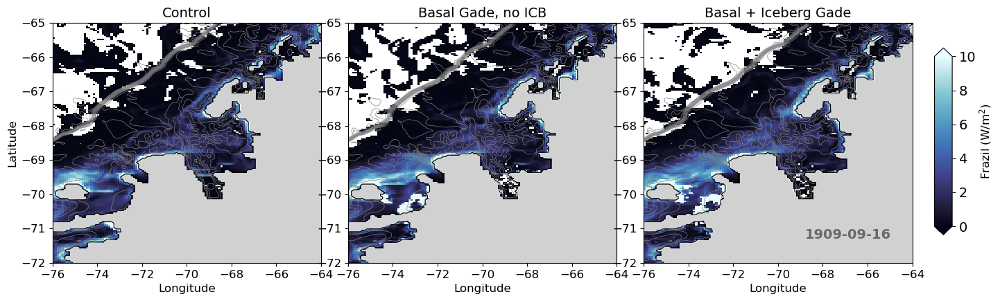

200.92545 5200.8374 6644.8667


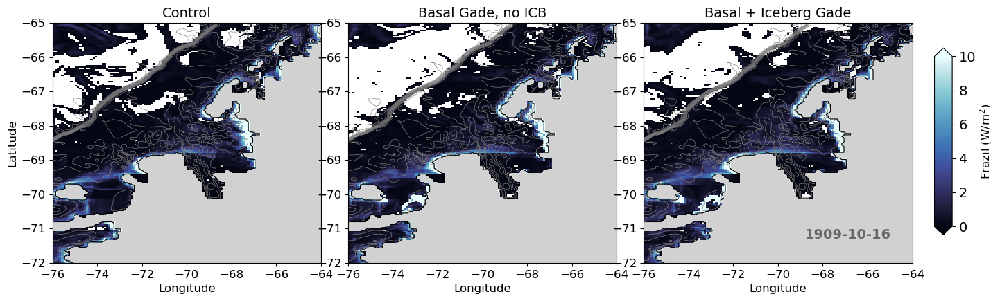

129.584 5359.144 7033.7607


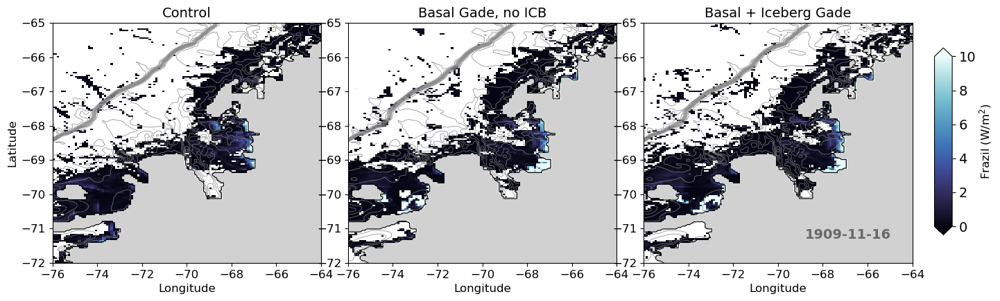

9.45964 5069.68 5675.7993


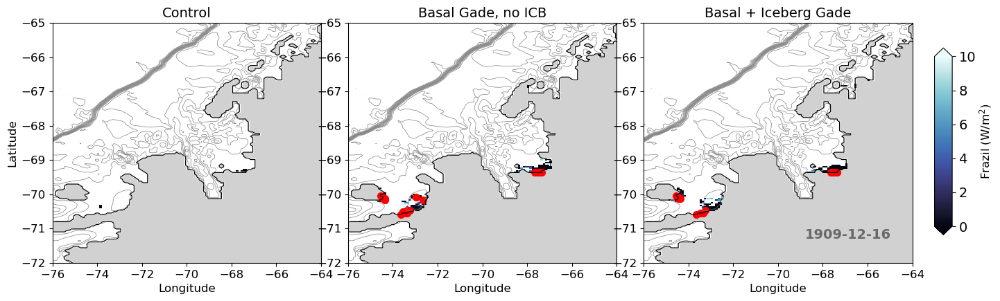

In [230]:
vmax = 10
for t in range(12):
    max_frazil = frazil_3d_int_z_cntl.isel(time=t).max().values
    print(max_frazil, frazil_3d_int_z_basal.isel(time=t).max().values, frazil_3d_int_z_icb.isel(time=t).max().values)
    frazil_mag = max_frazil*10
    fig, axes = figure_frazil(-76, -64, -72, -65)
    axes[0].pcolormesh(frazil_3d_int_z_cntl.xt_ocean, frazil_3d_int_z_cntl.yt_ocean, 
                       frazil_3d_int_z_cntl.isel(time=t).where(frazil_3d_int_z_cntl.isel(time=t) >0), 
                       zorder=1, cmap=cmo.cm.ice, vmin=0, vmax=vmax)
    axes[1].pcolormesh(frazil_3d_int_z_basal.xt_ocean, frazil_3d_int_z_basal.yt_ocean, 
                       frazil_3d_int_z_basal.isel(time=t).where(frazil_3d_int_z_basal.isel(time=t) >0), 
                       zorder=1, cmap=cmo.cm.ice, vmin=0, vmax=vmax)
    cb = axes[2].pcolormesh(frazil_3d_int_z_icb.xt_ocean, frazil_3d_int_z_icb.yt_ocean, 
                       frazil_3d_int_z_icb.isel(time=t).where(frazil_3d_int_z_icb.isel(time=t) >0), 
                       zorder=1, cmap=cmo.cm.ice, vmin=0, vmax=vmax)
    loc_indexes = np.where(frazil_3d_int_z_cntl.isel(time=t) > frazil_mag)
    axes[0].scatter(frazil_3d_int_z_cntl.xt_ocean[loc_indexes[1]], frazil_3d_int_z_cntl.yt_ocean[loc_indexes[0]], 
                    c ='r', s=50)
    loc_indexes = np.where(frazil_3d_int_z_basal.isel(time=t) > frazil_mag)
    axes[1].scatter(frazil_3d_int_z_basal.xt_ocean[loc_indexes[1]], frazil_3d_int_z_basal.yt_ocean[loc_indexes[0]], 
                    c ='r', s=50)
    loc_indexes = np.where(frazil_3d_int_z_icb.isel(time=t) > frazil_mag)
    axes[2].scatter(frazil_3d_int_z_icb.xt_ocean[loc_indexes[1]], frazil_3d_int_z_icb.yt_ocean[loc_indexes[0]], 
                    c ='r', s=50)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,f'Frazil (W/m$^2$)')
    axes[2].text(0.6, 0.1, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=14, fontweight='bold', color='dimgrey', transform=axes[2].transAxes)
    plt.show()

Differences from control. 

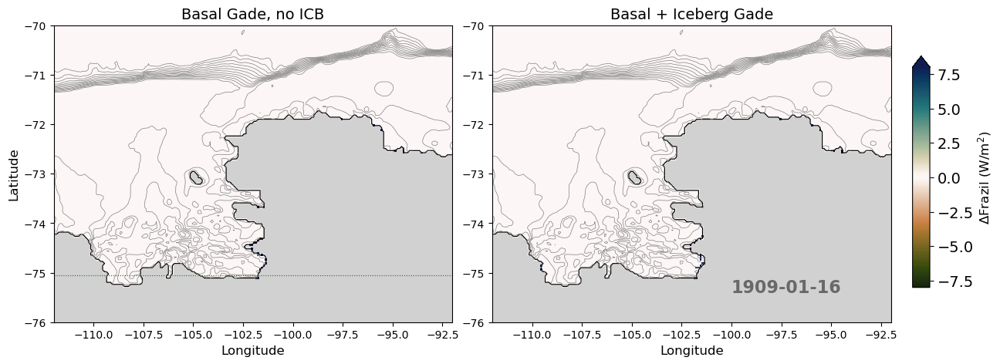

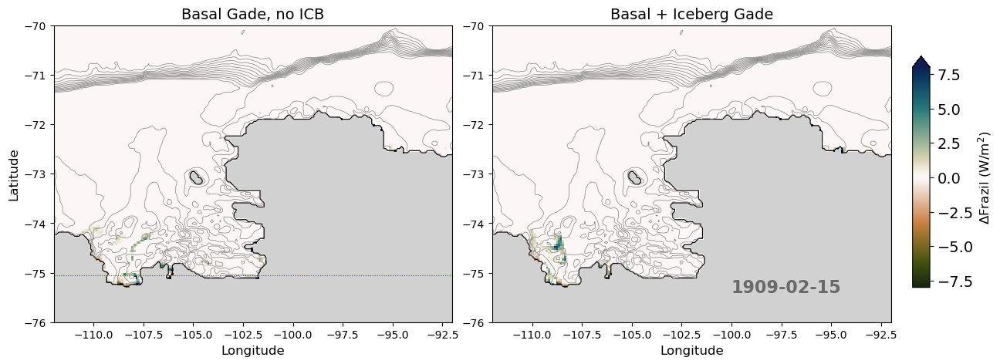

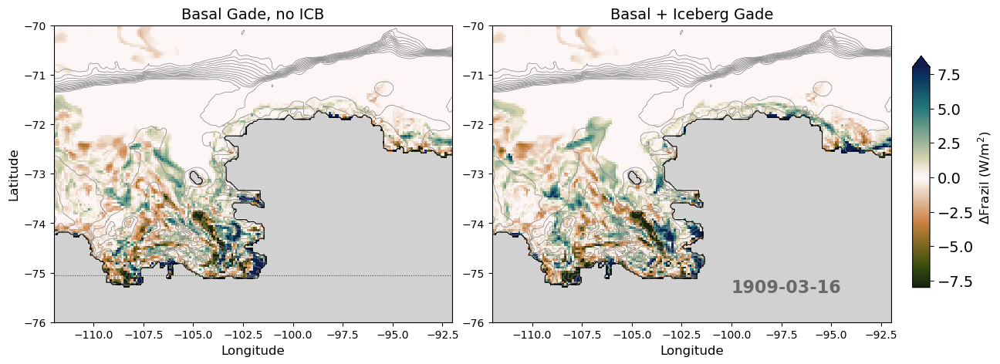

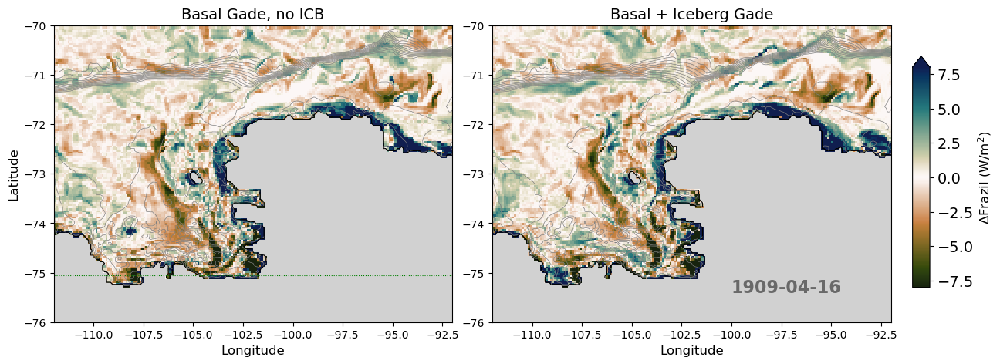

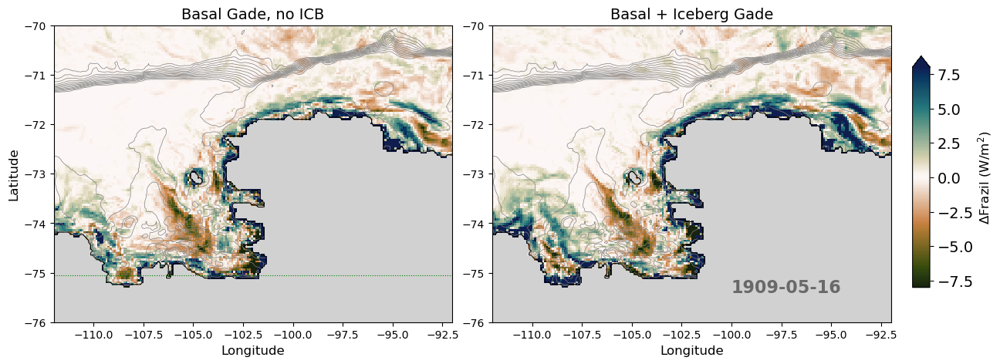

...

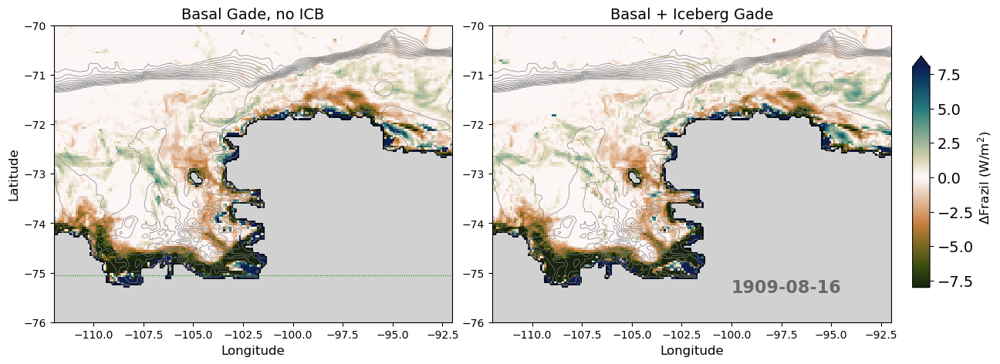

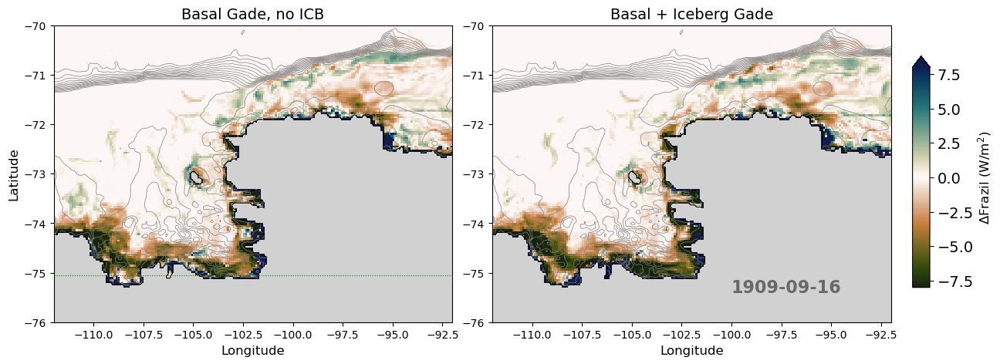

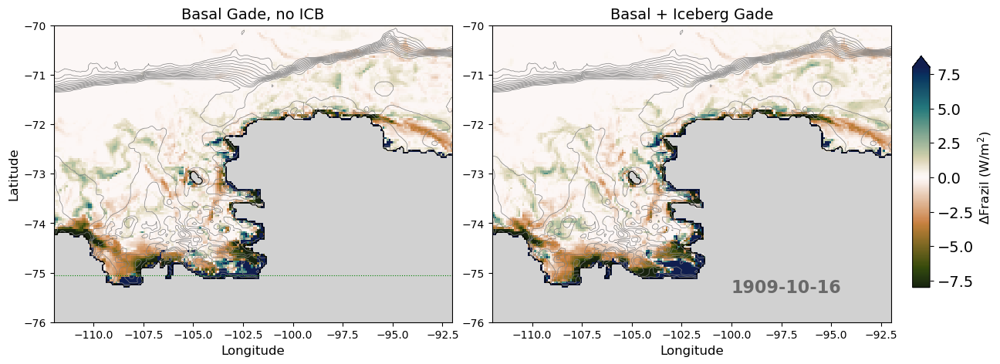

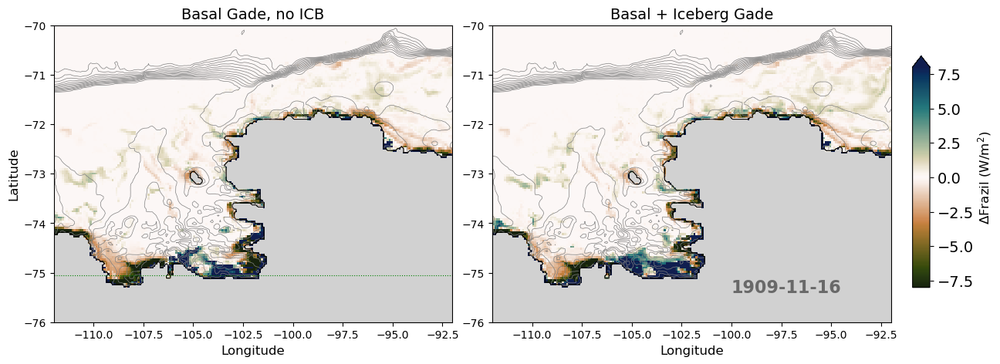

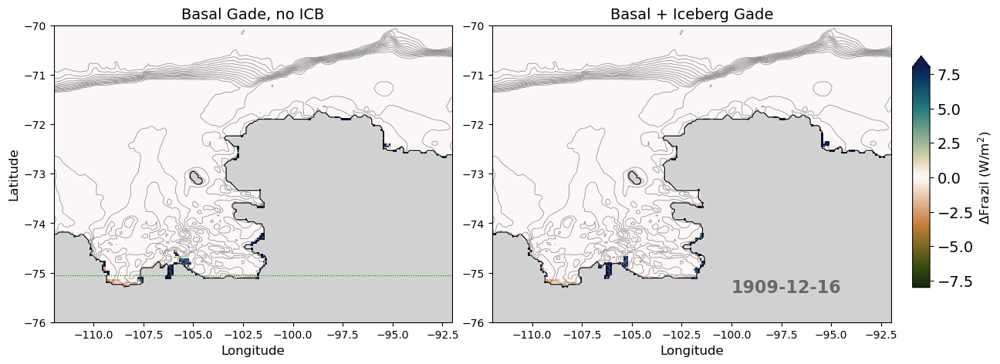

In [146]:
for t in range(12):
    fig, axes = figure(-112, -92, -76, -70)
    axes[0].pcolormesh(frazil_3d_int_z_basal.xt_ocean, frazil_3d_int_z_basal.yt_ocean, 
                       (frazil_3d_int_z_basal.isel(time=t) - frazil_3d_int_z_cntl.isel(time=t)), 
                       zorder=1, cmap=cmo.cm.tarn, vmin=-1000, vmax=1000)
    cb = axes[1].pcolormesh(frazil_3d_int_z_icb.xt_ocean, frazil_3d_int_z_icb.yt_ocean, 
                            (frazil_3d_int_z_icb.isel(time=t) - frazil_3d_int_z_cntl.isel(time=t)), 
                       zorder=1, cmap=cmo.cm.tarn, vmin=-1000, vmax=1000)
    plot_colorbar(fig,[0.92, 0.2, 0.016, 0.6],cb,f'$\Delta$Frazil (W/m$^2$)')
    axes[1].text(0.6, 0.1, f'{str(temp_basal_cold.isel(time=t).time.values)[:10]}', 
             fontsize=16, fontweight='bold', color='dimgrey', transform=axes[1].transAxes)
    axes[0].plot([-112,-92],[-75.05, -75.05], lw=0.8, ls=':',c='g')
    plt.show()

# Regional T-S plots

Define functions to read in data from control and simulation

In [4]:
def read_and_convert_TS(lat_slice, lon_slice, start_time, end_time):
    '''
    Reads T and S from control and Tfreeze_min simulation
    Restricts to shelf and region given by lat_slice and lon_slice
    Convert TS using gsw
    '''
    
    # control run
    temp = cc.querying.getvar(control, 'temp', master_session, frequency='1 monthly',
                              start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)
    salt = cc.querying.getvar(control, 'salt', master_session, frequency='1 monthly',
                              start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)
    ## Basal Gade run
    temp_basal_gade = cc.querying.getvar(basal_gade, 'temp', basal_melt_session, frequency='1 monthly',
                                          start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)
    salt_basal_gade = cc.querying.getvar(basal_gade, 'salt', basal_melt_session, frequency='1 monthly',
                                          start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)
    # ICB Gade run
    temp_icb_gade = cc.querying.getvar(icb_gade, 'temp', basal_melt_session, frequency='1 monthly',
                                          start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)
    salt_icb_gade = cc.querying.getvar(icb_gade, 'salt', basal_melt_session, frequency='1 monthly',
                                          start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)

    # subset temp and salinity only for shelf values
    temp = temp.where(ht<1000)
    salt = salt.where(ht<1000)
    temp_basal_gade = temp_basal_gade.where(ht<1000)
    salt_basal_gade = salt_basal_gade.where(ht<1000)
    temp_icb_gade = temp_icb_gade.where(ht<1000)
    salt_icb_gade = salt_icb_gade.where(ht<1000)
    
    # interpolate to evenly spaced 50 m vertical grid and load data
    z_even = np.arange(1,1051,50)
    salt = salt.interp(st_ocean = z_even).load()
    temp = temp.interp(st_ocean = z_even).load()
    salt_basal_gade = salt_basal_gade.interp(st_ocean = z_even).load()
    temp_basal_gade = temp_basal_gade.interp(st_ocean = z_even).load()
    salt_icb_gade = salt_icb_gade.interp(st_ocean = z_even).load()
    temp_icb_gade = temp_icb_gade.interp(st_ocean = z_even).load()

    # subset for first region and load data
    #temp = temp.load()
    #salt = salt.load()
    #temp_basal_gade = temp_basal_gade.load()
    #salt_basal_gade= salt_basal_gade.load()
    #temp_icb_gade = temp_icb_gade.load()
    #salt_icb_gade= salt_icb_gade.load()
    print('Temp is' , temp.nbytes/1000**3, 'GB')
    
    # convert Temp to deg C
    temp = temp - 273.15
    temp_basal_gade = temp_basal_gade - 273.15
    temp_icb_gade = temp_icb_gade - 273.15
    # convert salinity (psu) to absolute salinity
    p = gsw.p_from_z(-salt.st_ocean,salt.yt_ocean)
    salt = gsw.SA_from_SP(salt, p, salt.xt_ocean, salt.yt_ocean)
    salt_basal_gade = gsw.SA_from_SP(salt_basal_gade, p, salt_basal_gade.xt_ocean, salt_basal_gade.yt_ocean)
    salt_icb_gade = gsw.SA_from_SP(salt_icb_gade, p, salt_icb_gade.xt_ocean, salt_icb_gade.yt_ocean)
     
    return temp,salt,temp_basal_gade,salt_basal_gade,temp_icb_gade,salt_icb_gade


Define figure functions

In [5]:
def figure(region):
    plt.rcParams['font.size'] = 13
    fig, axes = plt.subplots(1,3, figsize=(21,6))
    sig_lvls = [24, 24.5, 25, 25.5, 26, 26.5, 27, 27.25, 27.5, 27.75, 28, 28.25, 28.5]
    for ax in axes.flatten():
        ax.set_ylim([-2,2])
        ax.set_xlim([32,35])
        ax.set_ylabel('Conservative Temperature (\u00b0C)')
        ax.set_xlabel('Absolute Salinity (g/kg)')
        cl = ax.contour(salt_mesh,temp_mesh,sigma0_for_contouring, sig_lvls,colors='lightgrey',linewidths=1)
        ax.clabel(cl, sig_lvls)
        
        salt_arr = np.arange(27, 37, 0.1)
        tfreeze_arr = gsw.CT_freezing(salt_arr, 1, 0.1)
        ax.plot(salt_arr, tfreeze_arr, 'dimgrey', lw=1, ls='--')
        
    return fig, axes, region

def create_colour_array(salt):
    # create depth arrays for colouring scatter plot
    depth = salt.copy(deep=True)
    depth.rename('depth')
    for i in range(len(depth.st_ocean)):
        depth[:,i,:,:] = depth.st_ocean[i]

    # create latitude arrays for colouring scatter plot
    lat_arr = salt.copy(deep=True)
    lat_arr.rename('lat')
    for i in range(len(salt.yt_ocean)):
        lat_arr[:,:,i,:] = lat_arr.yt_ocean[i]
        
    return depth, lat_arr

# create density mesh for contours on T-S
temp_vals = np.arange(-3.5,2,.1)
salt_vals = np.arange(26,36.5,.01) 
temp_mesh,salt_mesh = np.meshgrid(temp_vals,salt_vals)
density_for_contouring = gsw.density.rho(salt_mesh, temp_mesh, 1) #- 1000
sigma0_for_contouring = gsw.density.sigma0(salt_mesh, temp_mesh)
sigma1_for_contouring = gsw.density.sigma1(salt_mesh, temp_mesh)

# define colourmap for T-S plots
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap
cmap = plt.get_cmap('YlGnBu')
new_cmap = truncate_colormap(cmap, 0.2, 1)
new_cmap


## Regions:
- Southern Weddell Sea
- Southwest Ross Sea
- Amery Ice Shelf
- Amundsen Sea
- Bellingshausen Sea
- East Antarctica Adelie region

In [6]:
def plot_box(lon1, lon2,lat1, lat2):
    plt.plot([lon1,lon1],[lat1,lat2],c='k')
    plt.plot([lon2,lon2],[lat1,lat2],c='k')
    plt.plot([lon1,lon2],[lat1,lat1],c='k')
    plt.plot([lon1,lon2],[lat2,lat2],c='k')

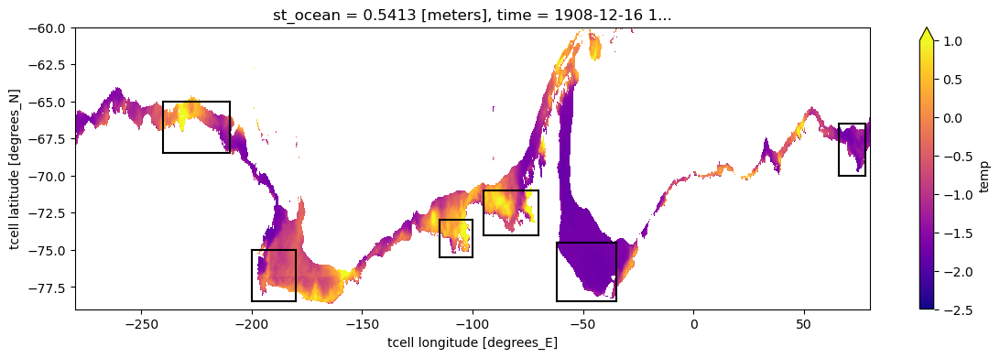

In [17]:
# last year only
start_time='1909-01-01'
end_time='1910-01-01'
lat_slice = slice(-79,-60)
lon_slice = slice(-280,80)
# read in T and S for region
temp = cc.querying.getvar(basal_gade, 'temp', basal_melt_session, frequency='1 monthly',
                              start_time=start_time, end_time=end_time).sel(yt_ocean=lat_slice).sel(xt_ocean=lon_slice)
temp = temp.where(ht<1000)
# plot regions of interest for quick reference check
(temp[0,0,:,:]-273.15).plot(figsize=(14,4), cmap='plasma', vmin=-2.5, vmax=1)

#amundsen
l,r = -115, -100
b,t = -75.5, -73
plot_box(l,r,b,t)
#bellingshausen
l,r = -95, -70
b,t = -74, -71
plot_box(l,r,b,t)
#Cape Darnley region
l,r = 66, 78
b,t = -70, -66.5
plot_box(l,r,b,t)
#East Antarctica - Adelie region
l,r = -240, -210
b,t = -68.5, -65
plot_box(l,r,b,t)
#south-west ross sea
l,r = -200, -180
b,t = -78.5, -75
plot_box(l,r,b,t)
#Southern weddell sea
l,r = -62, -35
b,t = -78.5, -74.5
plot_box(l, r,b, t)
# Antarctic Peninsula

plt.ylim(-79, -60)
plt.show()

In [94]:
bounds = {}
bounds['Cape Darnley'] = (66, 78, -70, -66.5)
bounds['East Antarctica - Adelie'] = (-240, -210, -68.5, -65)
bounds['Ross Sea'] = (-200, -180, -78.5, -75)
bounds['Amundsen Sea'] = (-115, -100, -75.5, -73)
bounds['Bellingshausen Sea'] = (-95, -70, -74, -71)
bounds['Weddell Sea'] = (-62, -35, -78.5, -74.5)

Cape Darnley (66, 78, -70, -66.5)
Temp is 0.0250992 GB


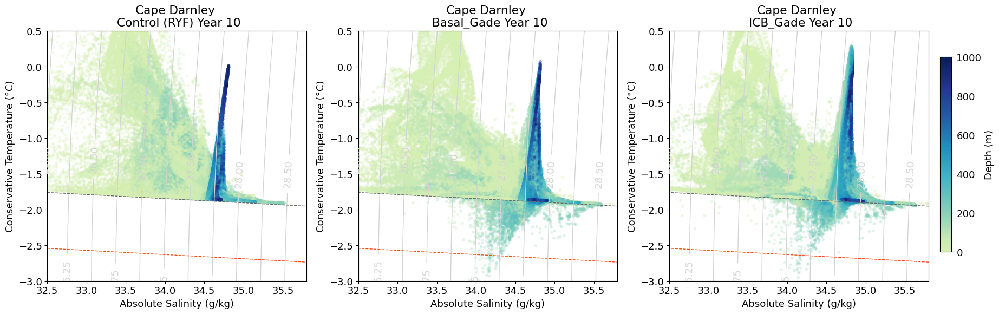

East Antarctica - Adelie (-240, -210, -68.5, -65)
Temp is 0.062748 GB


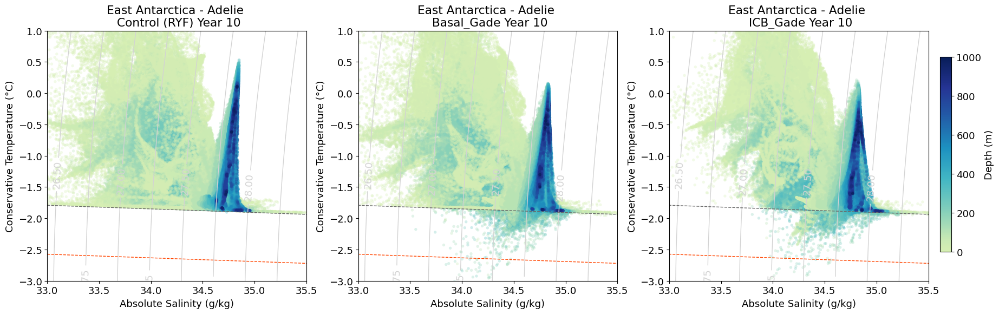

Ross Sea (-200, -180, -78.5, -75)
Temp is 0.041832 GB


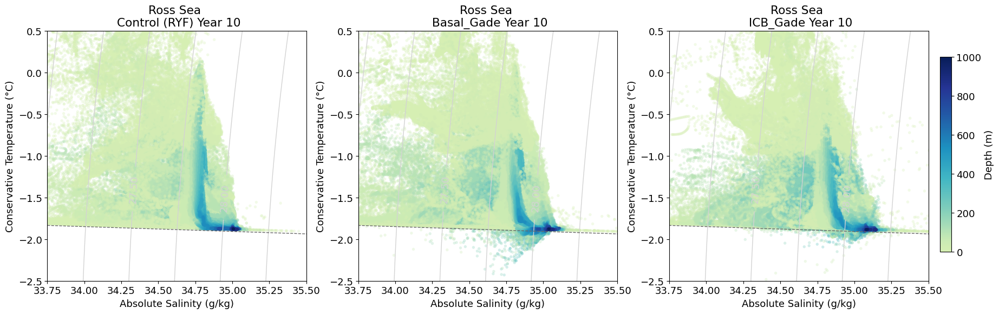

Amundsen Sea (-115, -100, -75.5, -73)
Temp is 0.022302 GB


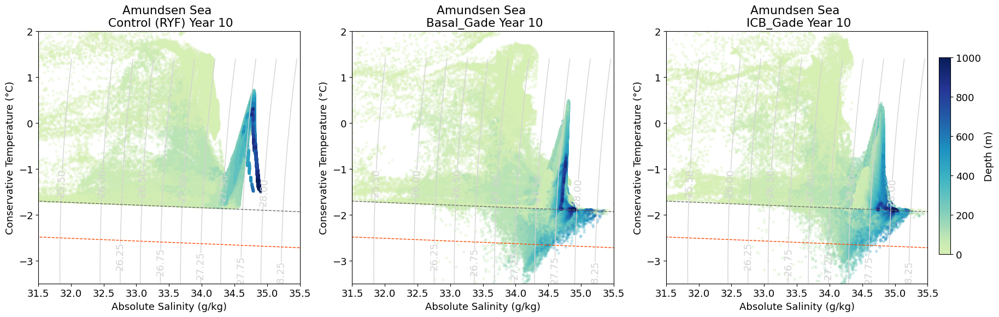

Bellingshausen Sea (-95, -70, -74, -71)
Temp is 0.04473 GB


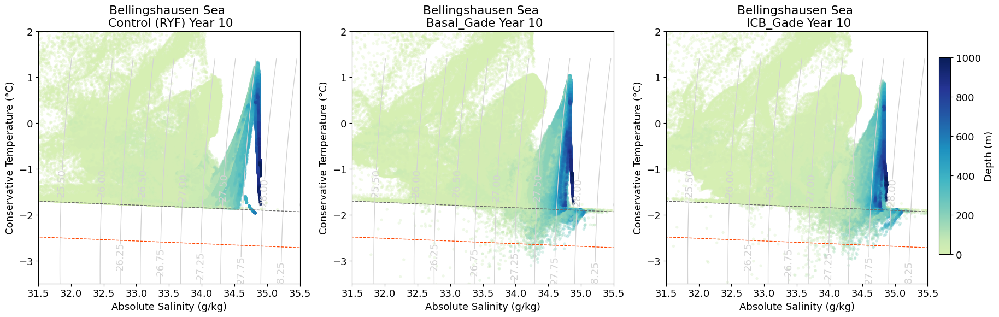

Weddell Sea (-62, -35, -78.5, -74.5)
Temp is 0.064638 GB


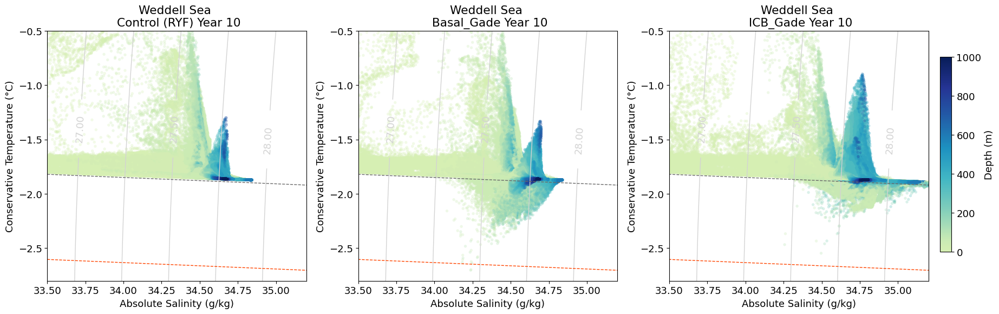

In [113]:
# last year only
start_time='1909-01-01'
end_time='1910-01-01'

for key in bounds:
    print(key, bounds[key])
    l,r,b,t = bounds[key]
    lat_slice = slice(b,t)
    lon_slice = slice(l,r)
    
    # read in T and S for region
    temp,salt,temp_basal_gade,salt_basal_gade,temp_icb_gade,salt_icb_gade = read_and_convert_TS(lat_slice, lon_slice, start_time, end_time)
    
    # create arrays for scatter colouring
    depth, lat_arr = create_colour_array(salt)
    depth_basal, lat_arr_basal = create_colour_array(salt_basal_gade)
    depth_icb, lat_arr_icb = create_colour_array(salt_icb_gade)
    
    # plot figure
    scatter_colour = ['depth']#,'lat']
    s, alph, cmap = 15, 0.3, new_cmap

    sa = np.arange(32,35,0.01)
    t_func_l = -3.4*sa+115.9
    t_func_r1 = 4.5*sa-155.6#155.8
    t_func_r2 = 8*sa-277.3#.43

    for f in range(1):
        fig, axes = figure()
        if scatter_colour[f] == 'depth':
            axes[0].scatter(salt,temp, c=depth, cmap=cmap, alpha=alph, s=s, edgecolors='none')
            axes[1].scatter(salt_basal_gade,temp_basal_gade, c=depth_basal, cmap=cmap, alpha=alph, s=s, edgecolors='none')
            c = axes[1].scatter(20,0, s=s, c=5, vmin=0, vmax=1000, cmap=cmap, alpha=1) # plot dummy point for colorbar sake
            axes[2].scatter(salt_icb_gade,temp_icb_gade, c=depth_icb, cmap=cmap, alpha=alph, s=s, edgecolors='none')
            plt.colorbar(c, cax = fig.add_axes([0.91, 0.2, 0.01, 0.6]), orientation = 'vertical').set_label('Depth (m)')
        else:
            axes[0].scatter(salt,temp, c=lat_arr, cmap=cmap, alpha=alph, s=s, edgecolors='none')
            c = axes[0].scatter(20,0, s=s, c=-70, vmin=lat_arr.min(), vmax=lat_arr.max(), cmap=cmap, alpha=1) # plot dummy point for colorbar sake
            axes[1].scatter(salt_basal_gade,temp_basal_gade, c=lat_arr_basal, cmap=cmap, alpha=alph, s=s, edgecolors='none')
            axes[2].scatter(salt_icb_gade,temp_icb_gade, c=lat_arr_icb, cmap=cmap, alpha=alph, s=s, edgecolors='none')
            plt.colorbar(c, cax = fig.add_axes([0.91, 0.2, 0.01, 0.6]), orientation = 'vertical').set_label('Latitude')

        axes[0].set_title(f'{key} \n Control (RYF) Year 10')
        axes[1].set_title(f'{key} \n Basal_Gade Year 10')
        axes[2].set_title(f'{key} \n ICB_Gade Year 10')
        
        if key == 'Ross Sea':
            for ax in axes.flatten():
                ax.set_xlim([33.75, 35.5])
                ax.set_ylim([-2.5, 0.5])
        elif key == 'Cape Darnley':
            for ax in axes.flatten():
                ax.set_xlim([32.5, 35.8])
                ax.set_ylim([-3, 0.5])
        elif key == 'East Antarctica - Adelie':
            for ax in axes.flatten():
                ax.set_xlim([33, 35.5])
                ax.set_ylim([-3, 1])
        elif key == 'Weddell Sea':
            for ax in axes.flatten():
                ax.set_xlim([33.5, 35.2])
                ax.set_ylim([-2.8, -0.5])
        else:
            for ax in axes.flatten():
                ax.set_xlim([31.5, 35.5])
                ax.set_ylim([-3.5, 2.0])
            
        plt.show()
        
        